# Build a Conditional GAN

### Goals
In this notebook, you're going to make a conditional GAN in order to generate hand-written images of digits, conditioned on the digit to be generated (the class vector). This will let you choose what digit you want to generate.

You'll then do some exploration of the generated images to visualize what the noise and class vectors mean.  

### Learning Objectives
1.   Learn the technical difference between a conditional and unconditional GAN.
2.   Understand the distinction between the class and noise vector in a conditional GAN.



## Getting Started

For this assignment, you will be using the MNIST dataset again, but there's nothing stopping you from applying this generator code to produce images of animals conditioned on the species or pictures of faces conditioned on facial characteristics.

Note that this assignment requires no changes to the architectures of the generator or discriminator, only changes to the data passed to both. The generator will no longer take `z_dim` as an argument, but  `input_dim` instead, since you need to pass in both the noise and class vectors. In addition to good variable naming, this also means that you can use the generator and discriminator code you have previously written with different parameters.

You will begin by importing the necessary libraries and building the generator and discriminator.

#### Packages and Visualization

In [1]:
import torch
from torch import nn
from tqdm.auto import tqdm
from torchvision import transforms
from torchvision.datasets import MNIST
from torchvision.utils import make_grid
from torch.utils.data import DataLoader
import matplotlib.pyplot as plt
torch.manual_seed(0) # Set for our testing purposes, please do not change!

def show_tensor_images(image_tensor, num_images=25, size=(1, 28, 28), nrow=5, show=True):
    '''
    Function for visualizing images: Given a tensor of images, number of images, and
    size per image, plots and prints the images in an uniform grid.
    '''
    image_tensor = (image_tensor + 1) / 2
    image_unflat = image_tensor.detach().cpu()
    image_grid = make_grid(image_unflat[:num_images], nrow=nrow)
    plt.imshow(image_grid.permute(1, 2, 0).squeeze())
    if show:
        plt.show()

#### Generator and Noise

In [2]:
class Generator(nn.Module):
    '''
    Generator Class
    Values:
        input_dim: the dimension of the input vector, a scalar
        im_chan: the number of channels in the images, fitted for the dataset used, a scalar
              (MNIST is black-and-white, so 1 channel is your default)
        hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, input_dim=10, im_chan=1, hidden_dim=64):
        super(Generator, self).__init__()
        self.input_dim = input_dim
        # Build the neural network
        self.gen = nn.Sequential(
            self.make_gen_block(input_dim, hidden_dim * 4),
            self.make_gen_block(hidden_dim * 4, hidden_dim * 2, kernel_size=4, stride=1),
            self.make_gen_block(hidden_dim * 2, hidden_dim),
            self.make_gen_block(hidden_dim, im_chan, kernel_size=4, final_layer=True),
        )

    def make_gen_block(self, input_channels, output_channels, kernel_size=3, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a generator block of DCGAN;
        a transposed convolution, a batchnorm (except in the final layer), and an activation.
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.ReLU(inplace=True),
            )
        else:
            return nn.Sequential(
                nn.ConvTranspose2d(input_channels, output_channels, kernel_size, stride),
                nn.Tanh(),
            )

    def forward(self, noise):
        '''
        Function for completing a forward pass of the generator: Given a noise tensor, 
        returns generated images.
        Parameters:
            noise: a noise tensor with dimensions (n_samples, input_dim)
        '''
        x = noise.view(len(noise), self.input_dim, 1, 1)
        return self.gen(x)

def get_noise(n_samples, input_dim, device='cpu'):
    '''
    Function for creating noise vectors: Given the dimensions (n_samples, input_dim)
    creates a tensor of that shape filled with random numbers from the normal distribution.
    Parameters:
        n_samples: the number of samples to generate, a scalar
        input_dim: the dimension of the input vector, a scalar
        device: the device type
    '''
    return torch.randn(n_samples, input_dim, device=device)

#### Discriminator

In [3]:
class Discriminator(nn.Module):
    '''
    Discriminator Class
    Values:
      im_chan: the number of channels in the images, fitted for the dataset used, a scalar
            (MNIST is black-and-white, so 1 channel is your default)
      hidden_dim: the inner dimension, a scalar
    '''
    def __init__(self, im_chan=1, hidden_dim=64):
        super(Discriminator, self).__init__()
        self.disc = nn.Sequential(
            self.make_disc_block(im_chan, hidden_dim),
            self.make_disc_block(hidden_dim, hidden_dim * 2),
            self.make_disc_block(hidden_dim * 2, 1, final_layer=True),
        )

    def make_disc_block(self, input_channels, output_channels, kernel_size=4, stride=2, final_layer=False):
        '''
        Function to return a sequence of operations corresponding to a discriminator block of the DCGAN; 
        a convolution, a batchnorm (except in the final layer), and an activation (except in the final layer).
        Parameters:
            input_channels: how many channels the input feature representation has
            output_channels: how many channels the output feature representation should have
            kernel_size: the size of each convolutional filter, equivalent to (kernel_size, kernel_size)
            stride: the stride of the convolution
            final_layer: a boolean, true if it is the final layer and false otherwise 
                      (affects activation and batchnorm)
        '''
        if not final_layer:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
                nn.BatchNorm2d(output_channels),
                nn.LeakyReLU(0.2, inplace=True),
            )
        else:
            return nn.Sequential(
                nn.Conv2d(input_channels, output_channels, kernel_size, stride),
            )

    def forward(self, image):
        '''
        Function for completing a forward pass of the discriminator: Given an image tensor, 
        returns a 1-dimension tensor representing fake/real.
        Parameters:
            image: a flattened image tensor with dimension (im_chan)
        '''
        disc_pred = self.disc(image)
        return disc_pred.view(len(disc_pred), -1)

## Class Input

In conditional GANs, the input vector for the generator will also need to include the class information. The class is represented using a one-hot encoded vector where its length is the number of classes and each index represents a class. The vector is all 0's and a 1 on the chosen class. Given the labels of multiple images (e.g. from a batch) and number of classes, please create one-hot vectors for each label. There is a class within the PyTorch functional library that can help you.

<details>

<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">get_one_hot_labels</font></code></b>
</font>
</summary>

1.   This code can be done in one line.
2.   The documentation for [F.one_hot](https://pytorch.org/docs/stable/nn.functional.html#torch.nn.functional.one_hot) may be helpful.

</details>


In [4]:
# UNQ_C1 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_one_hot_labels

import torch.nn.functional as F
def get_one_hot_labels(labels, n_classes):
    '''
    Function for creating one-hot vectors for the labels, returns a tensor of shape (?, num_classes).
    Parameters:
        labels: tensor of labels from the dataloader, size (?)
        n_classes: the total number of classes in the dataset, an integer scalar
    '''
    #### START CODE HERE ####
    return nn.functional.one_hot(labels, num_classes=n_classes)
    #### END CODE HERE ####

In [5]:
assert (
    get_one_hot_labels(
        labels=torch.Tensor([[0, 2, 1]]).long(),
        n_classes=3
    ).tolist() == 
    [[
      [1, 0, 0], 
      [0, 0, 1], 
      [0, 1, 0]
    ]]
)
print("Success!")

Success!


Next, you need to be able to concatenate the one-hot class vector to the noise vector before giving it to the generator. You will also need to do this when adding the class channels to the discriminator.

To do this, you will need to write a function that combines two vectors. Remember that you need to ensure that the vectors are the same type: floats. Again, you can look to the PyTorch library for help.
<details>
<summary>
<font size="3" color="green">
<b>Optional hints for <code><font size="4">combine_vectors</font></code></b>
</font>
</summary>

1.   This code can also be written in one line.
2.   The documentation for [torch.cat](https://pytorch.org/docs/master/generated/torch.cat.html) may be helpful.
3.   Specifically, you might want to look at what the `dim` argument of `torch.cat` does.

</details>


In [6]:
# UNQ_C2 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: combine_vectors
def combine_vectors(x, y):
    '''
    Function for combining two vectors with shapes (n_samples, ?) and (n_samples, ?).
    Parameters:
      x: (n_samples, ?) the first vector. 
        In this assignment, this will be the noise vector of shape (n_samples, z_dim), 
        but you shouldn't need to know the second dimension's size.
      y: (n_samples, ?) the second vector.
        Once again, in this assignment this will be the one-hot class vector 
        with the shape (n_samples, n_classes), but you shouldn't assume this in your code.
    '''
    # Note: Make sure this function outputs a float no matter what inputs it receives
    #### START CODE HERE ####
    combined = torch.cat((x.float(), y.float()), 1)
    #### END CODE HERE ####
    return combined

In [7]:
combined = combine_vectors(torch.tensor([[1, 2], [3, 4]]), torch.tensor([[5, 6], [7, 8]]));
# Check exact order of elements
assert torch.all(combined == torch.tensor([[1, 2, 5, 6], [3, 4, 7, 8]]))
# Tests that items are of float type
assert (type(combined[0][0].item()) == float)
# Check shapes
combined = combine_vectors(torch.randn(1, 4, 5), torch.randn(1, 8, 5));
assert tuple(combined.shape) == (1, 12, 5)
assert tuple(combine_vectors(torch.randn(1, 10, 12).long(), torch.randn(1, 20, 12).long()).shape) == (1, 30, 12)
print("Success!")

Success!


## Training
Now you can start to put it all together!
First, you will define some new parameters:

*   mnist_shape: the number of pixels in each MNIST image, which has dimensions 28 x 28 and one channel (because it's black-and-white) so 1 x 28 x 28
*   n_classes: the number of classes in MNIST (10, since there are the digits from 0 to 9)

In [8]:
mnist_shape = (1, 28, 28)
n_classes = 10

And you also include the same parameters from previous assignments:

  *   criterion: the loss function
  *   n_epochs: the number of times you iterate through the entire dataset when training
  *   z_dim: the dimension of the noise vector
  *   display_step: how often to display/visualize the images
  *   batch_size: the number of images per forward/backward pass
  *   lr: the learning rate
  *   device: the device type


In [9]:
criterion = nn.BCEWithLogitsLoss()
n_epochs = 200
z_dim = 64
display_step = 500
batch_size = 128
lr = 0.0002
device = 'cuda'

transform = transforms.Compose([
    transforms.ToTensor(),
    transforms.Normalize((0.5,), (0.5,)),
])

dataloader = DataLoader(
    MNIST('.', download=False, transform=transform),
    batch_size=batch_size,
    shuffle=True)

Then, you can initialize your generator, discriminator, and optimizers. To do this, you will need to update the input dimensions for both models. For the generator, you will need to calculate the size of the input vector; recall that for conditional GANs, the generator's input is the noise vector concatenated with the class vector. For the discriminator, you need to add a channel for every class.

In [10]:
# UNQ_C3 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED FUNCTION: get_input_dimensions
def get_input_dimensions(z_dim, mnist_shape, n_classes):
    '''
    Function for getting the size of the conditional input dimensions 
    from z_dim, the image shape, and number of classes.
    Parameters:
        z_dim: the dimension of the noise vector, a scalar
        mnist_shape: the shape of each MNIST image as (C, W, H), which is (1, 28, 28)
        n_classes: the total number of classes in the dataset, an integer scalar
                (10 for MNIST)
    Returns: 
        generator_input_dim: the input dimensionality of the conditional generator, 
                          which takes the noise and class vectors
        discriminator_im_chan: the number of input channels to the discriminator
                            (e.g. C x 28 x 28 for MNIST)
    '''
    #### START CODE HERE ####
    generator_input_dim = z_dim + n_classes
    discriminator_im_chan = mnist_shape[0] + n_classes 
    #### END CODE HERE ####
    return generator_input_dim, discriminator_im_chan

In [11]:
def test_input_dims():
    gen_dim, disc_dim = get_input_dimensions(23, (12, 23, 52), 9)
    assert gen_dim == 32
    assert disc_dim == 21
test_input_dims()
print("Success!")

Success!


In [12]:
generator_input_dim, discriminator_im_chan = get_input_dimensions(z_dim, mnist_shape, n_classes)

gen = Generator(input_dim=generator_input_dim).to(device)
gen_opt = torch.optim.Adam(gen.parameters(), lr=lr)
disc = Discriminator(im_chan=discriminator_im_chan).to(device)
disc_opt = torch.optim.Adam(disc.parameters(), lr=lr)

def weights_init(m):
    if isinstance(m, nn.Conv2d) or isinstance(m, nn.ConvTranspose2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
    if isinstance(m, nn.BatchNorm2d):
        torch.nn.init.normal_(m.weight, 0.0, 0.02)
        torch.nn.init.constant_(m.bias, 0)
gen = gen.apply(weights_init)
disc = disc.apply(weights_init)

Now to train, you would like both your generator and your discriminator to know what class of image should be generated. There are a few locations where you will need to implement code.

For example, if you're generating a picture of the number "1", you would need to:
  
1.   Tell that to the generator, so that it knows it should be generating a "1"
2.   Tell that to the discriminator, so that it knows it should be looking at a "1". If the discriminator is told it should be looking at a 1 but sees something that's clearly an 8, it can guess that it's probably fake

There are no explicit unit tests here -- if this block of code runs and you don't change any of the other variables, then you've done it correctly!

Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!



Step 500: Generator loss: 2.3177998402118685, discriminator loss: 0.2720268076993525


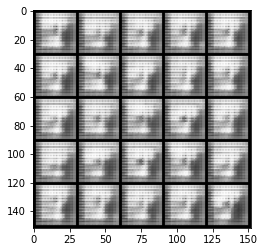

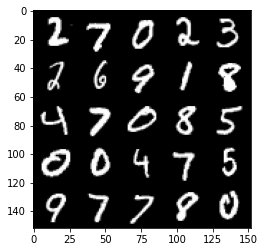

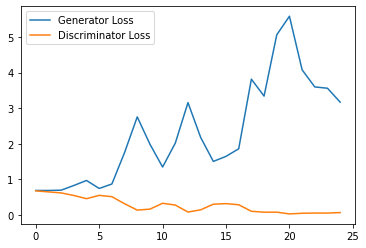

Step 1000: Generator loss: 4.405191924571991, discriminator loss: 0.0735592358969152


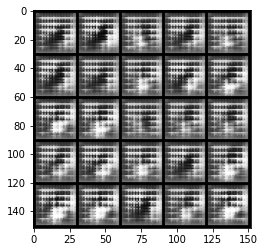

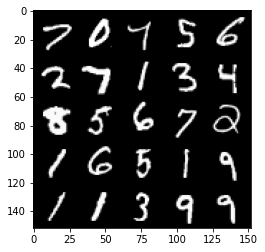

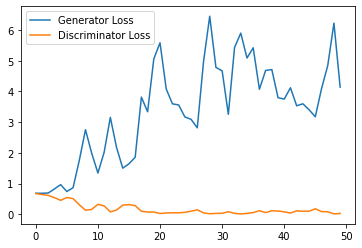

Step 1500: Generator loss: 4.857299084663391, discriminator loss: 0.04782690070848912


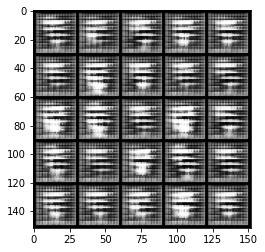

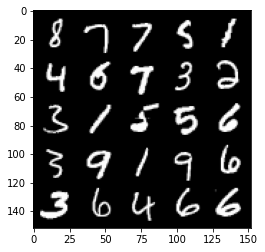

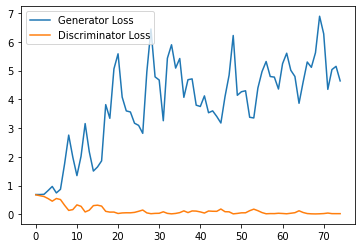

Step 2000: Generator loss: 4.708940274715424, discriminator loss: 0.04308581554889679


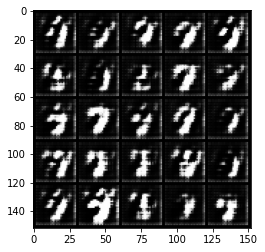

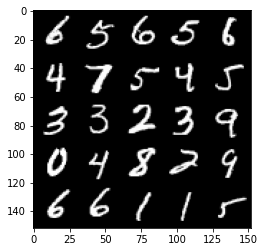

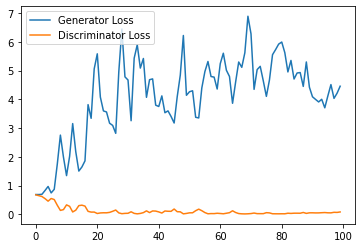

Step 2500: Generator loss: 3.4021553995609284, discriminator loss: 0.13176576805859805


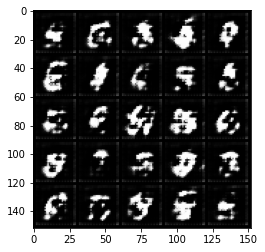

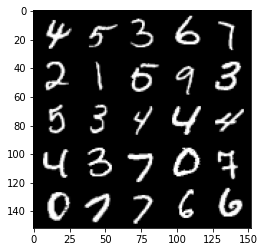

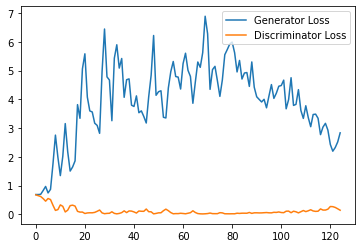

Step 3000: Generator loss: 2.601225766658783, discriminator loss: 0.2731126703172922


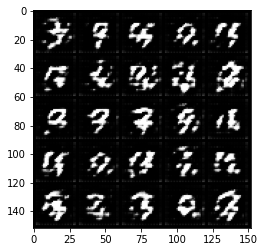

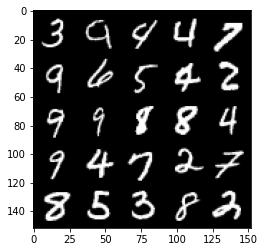

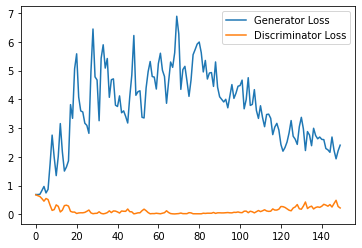

Step 3500: Generator loss: 2.094734927892685, discriminator loss: 0.30314113886654376


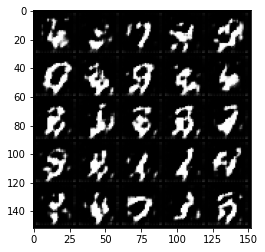

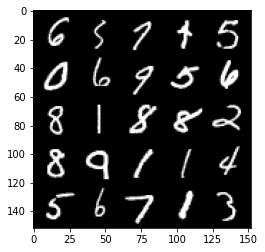

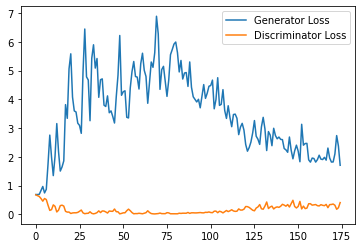

Step 4000: Generator loss: 2.083253138542175, discriminator loss: 0.29484234789013863


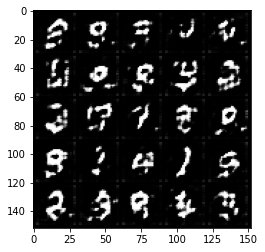

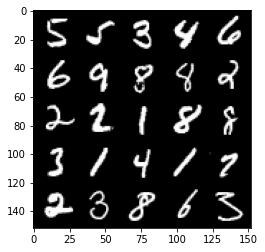

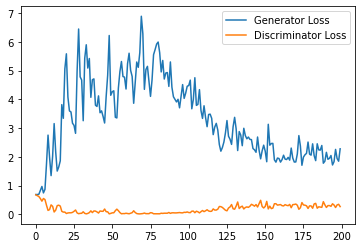

Step 4500: Generator loss: 2.0717304072380065, discriminator loss: 0.32885111340880396


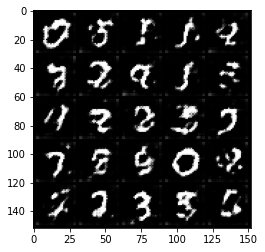

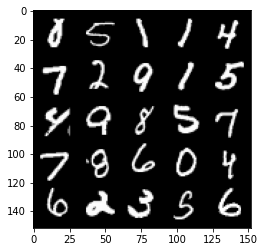

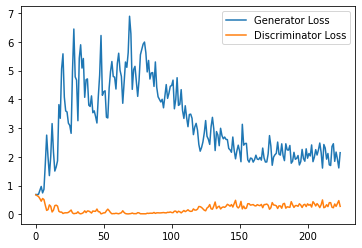

Step 5000: Generator loss: 1.9075000414848327, discriminator loss: 0.35783401495218276


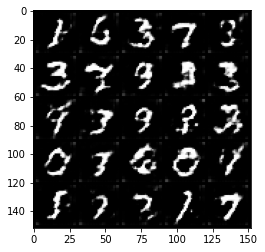

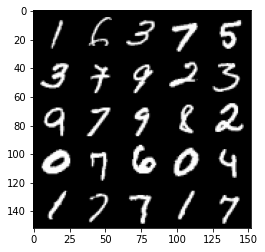

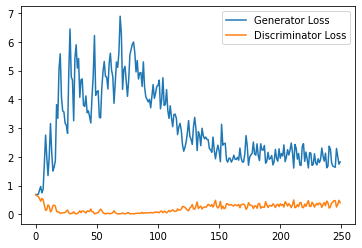

Step 5500: Generator loss: 1.8862317143678664, discriminator loss: 0.4013257348239422


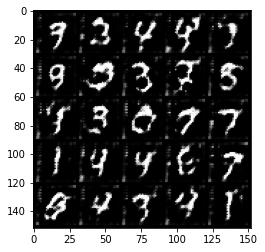

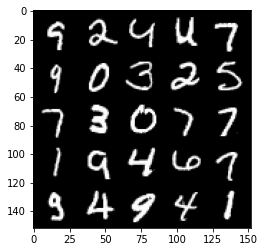

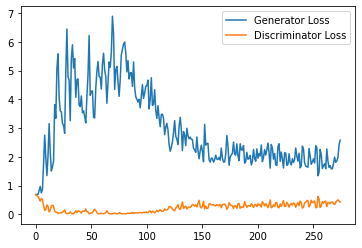

Step 6000: Generator loss: 1.724640085220337, discriminator loss: 0.4363793312907219


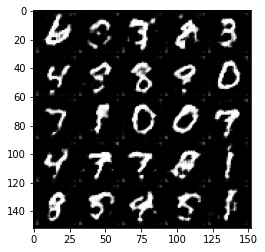

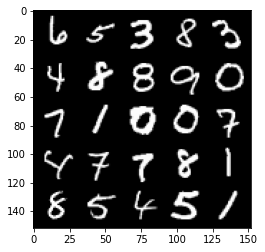

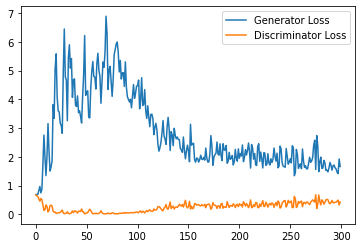

Step 6500: Generator loss: 1.5174182755947112, discriminator loss: 0.4466248554289341


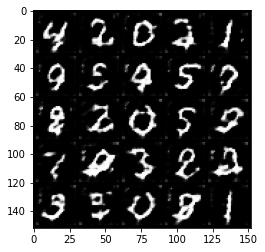

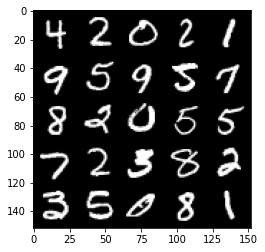

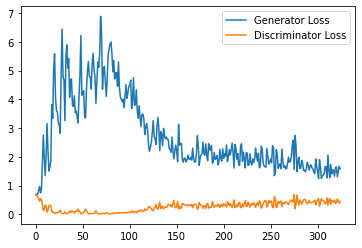

Step 7000: Generator loss: 1.4984274723529816, discriminator loss: 0.4585475361943245


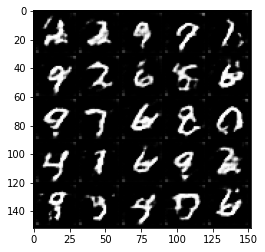

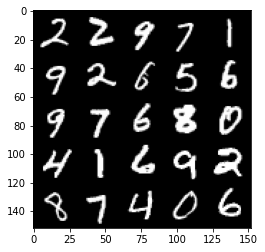

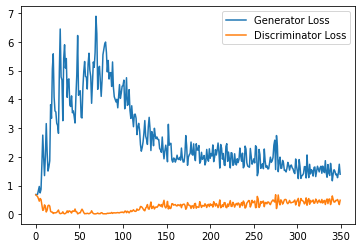

Step 7500: Generator loss: 1.418058479309082, discriminator loss: 0.47938975888490676


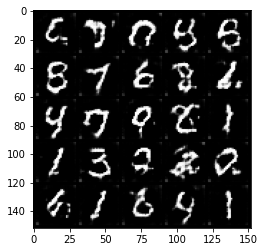

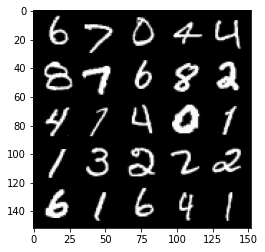

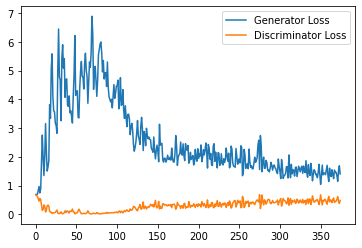

Step 8000: Generator loss: 1.4095041838884355, discriminator loss: 0.4926987103819847


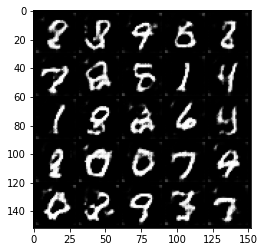

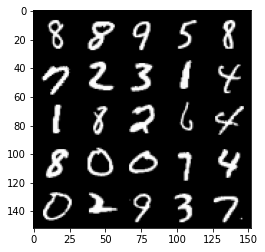

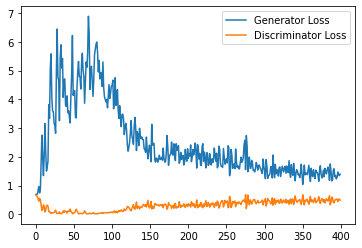

Step 8500: Generator loss: 1.4216507377624512, discriminator loss: 0.510375925540924


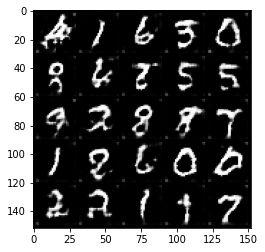

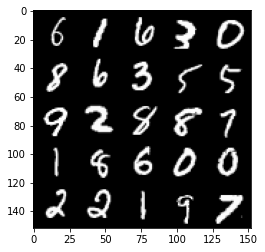

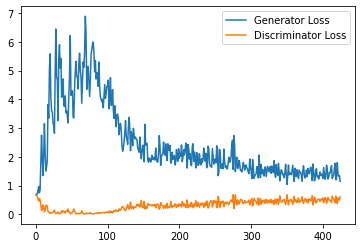

Step 9000: Generator loss: 1.345037389397621, discriminator loss: 0.5086045724153518


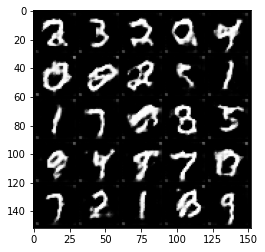

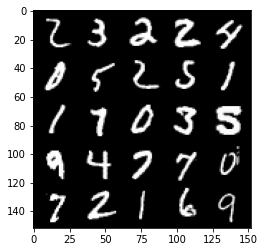

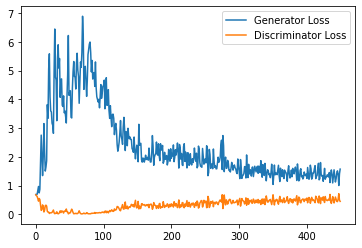

Step 9500: Generator loss: 1.312045742869377, discriminator loss: 0.527533748805523


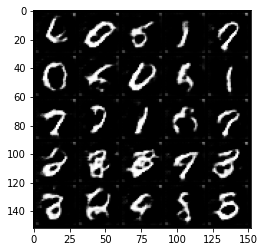

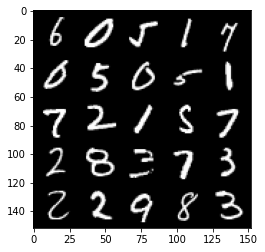

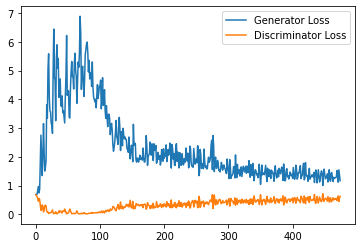

Step 10000: Generator loss: 1.2782068387269974, discriminator loss: 0.5263145781755447


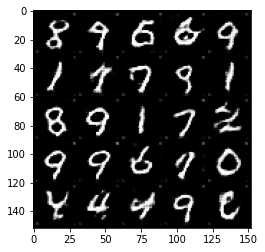

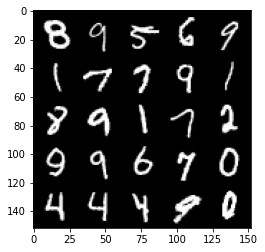

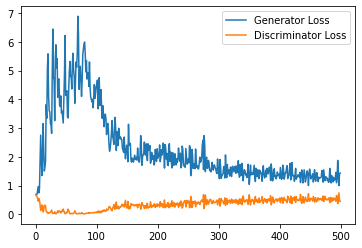

Step 10500: Generator loss: 1.2604176399707794, discriminator loss: 0.5339816827774048


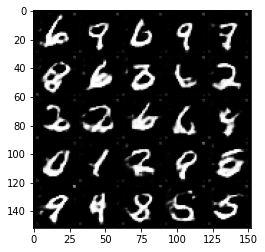

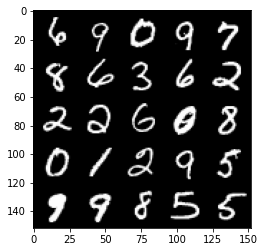

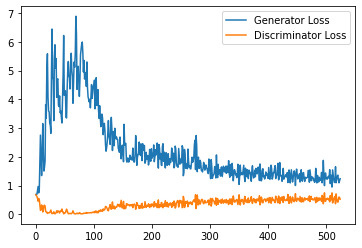

Step 11000: Generator loss: 1.2399633967876433, discriminator loss: 0.5331160770654678


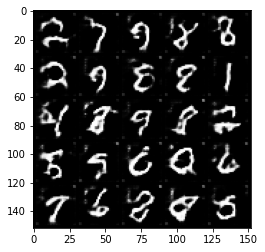

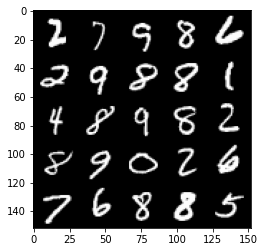

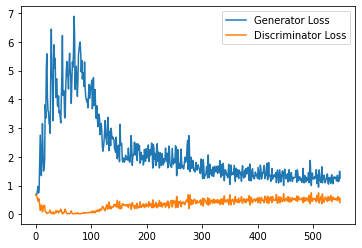

Step 11500: Generator loss: 1.2367747212648392, discriminator loss: 0.5390941941738129


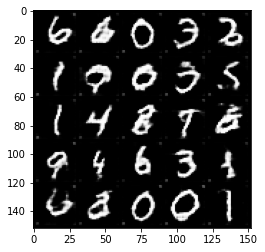

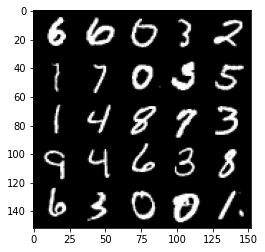

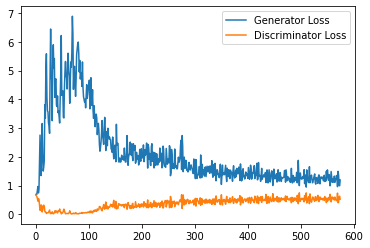

Step 12000: Generator loss: 1.221775800228119, discriminator loss: 0.543692730486393


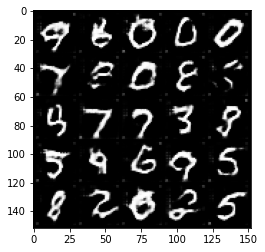

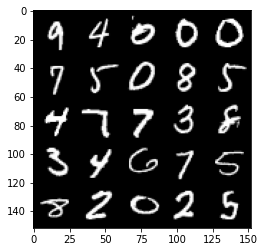

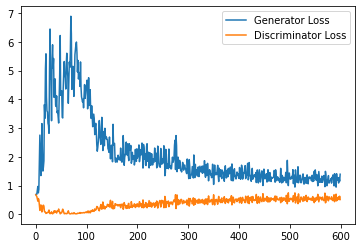

Step 12500: Generator loss: 1.1340718252658843, discriminator loss: 0.5467762845754623


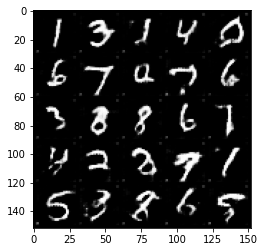

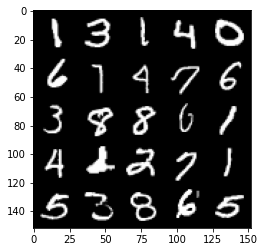

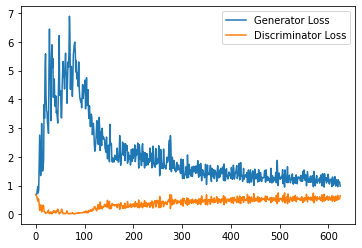

Step 13000: Generator loss: 1.1833877819776535, discriminator loss: 0.552352168738842


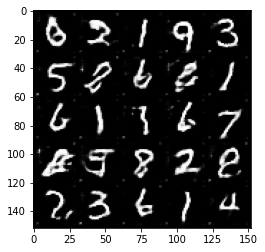

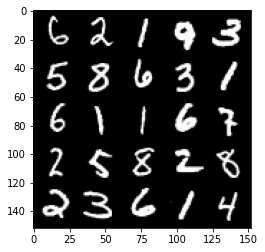

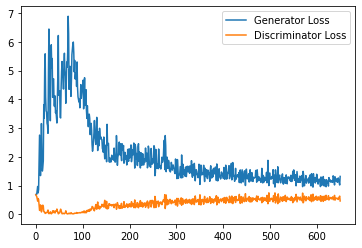

Step 13500: Generator loss: 1.1104714864492415, discriminator loss: 0.5625904526114464


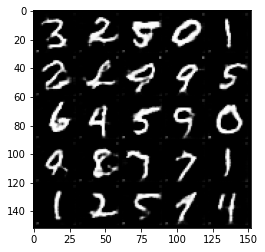

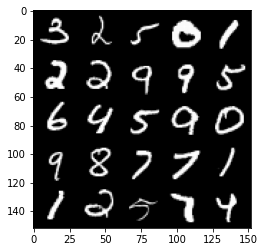

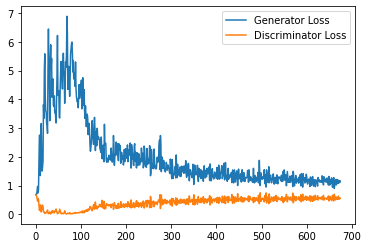

Step 14000: Generator loss: 1.111951379776001, discriminator loss: 0.5725236114263534


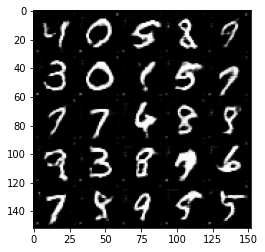

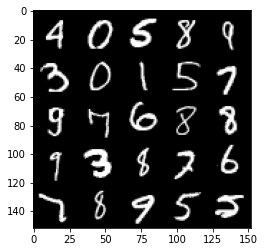

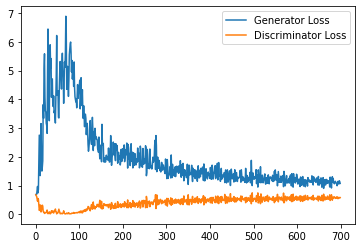

Step 14500: Generator loss: 1.10824859726429, discriminator loss: 0.5770967655777931


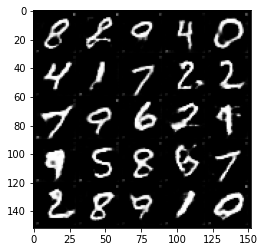

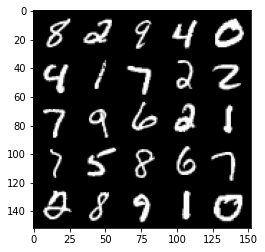

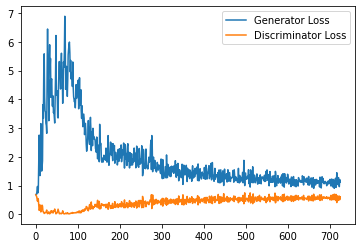

Step 15000: Generator loss: 1.0862719814777375, discriminator loss: 0.5851803604960442


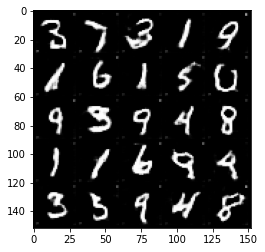

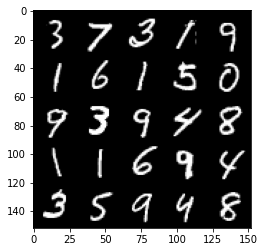

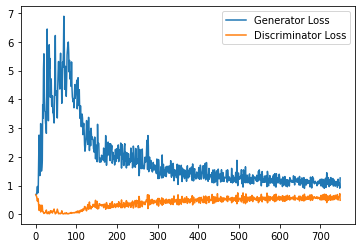

Step 15500: Generator loss: 1.0459346475601197, discriminator loss: 0.5912357935905457


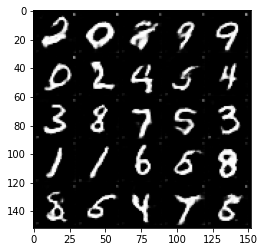

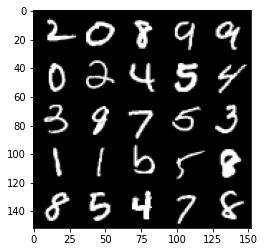

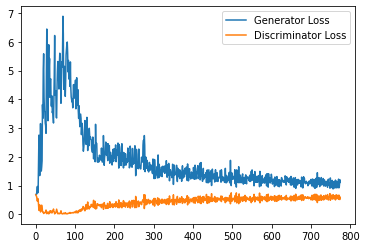

Step 16000: Generator loss: 1.0807025253772735, discriminator loss: 0.5869042852520943


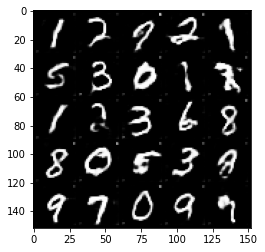

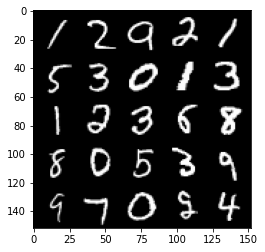

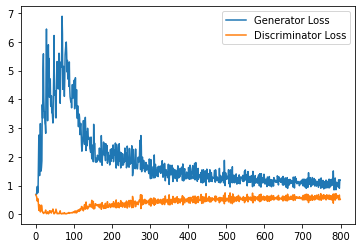

Step 16500: Generator loss: 1.0247624459266662, discriminator loss: 0.5909689731001854


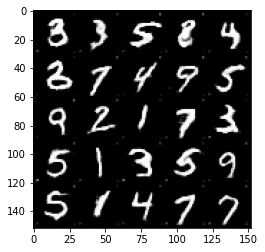

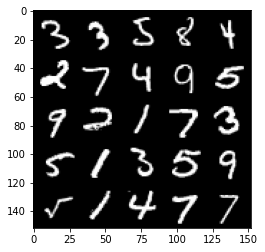

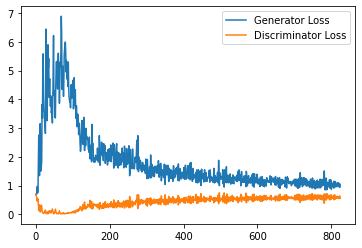

Step 17000: Generator loss: 1.0161206147670745, discriminator loss: 0.5951226550340653


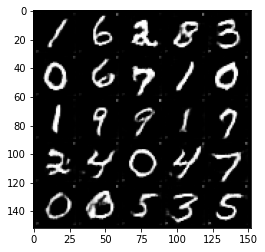

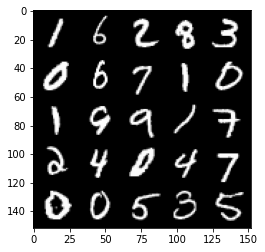

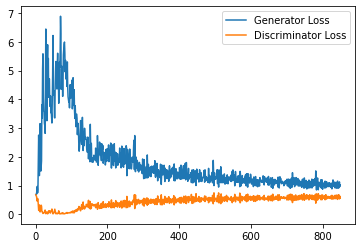

Step 17500: Generator loss: 1.0191211245059968, discriminator loss: 0.5930373851656914


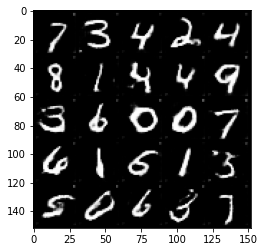

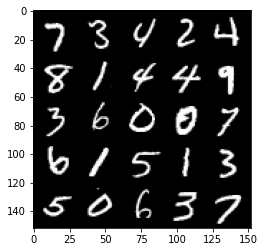

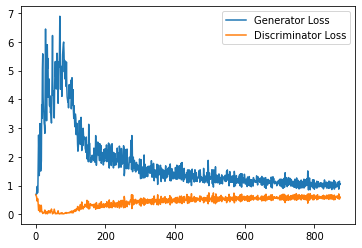

Step 18000: Generator loss: 1.0570568480491638, discriminator loss: 0.5973131927251816


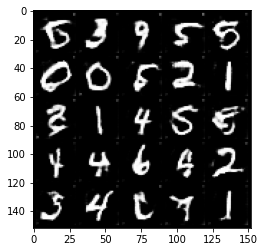

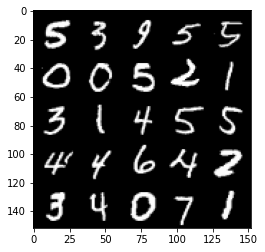

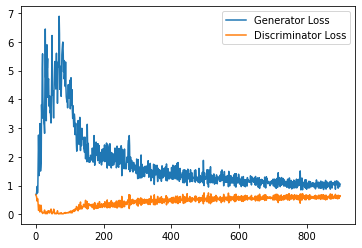

Step 18500: Generator loss: 1.045832386136055, discriminator loss: 0.5915741814374924


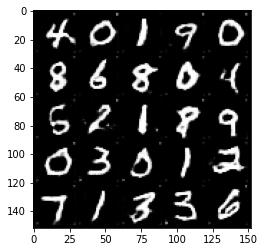

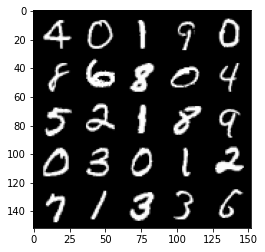

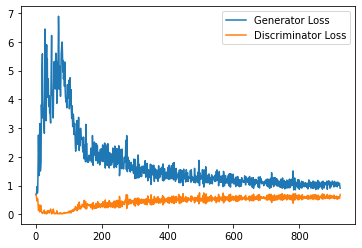

Step 19000: Generator loss: 0.9927024129629135, discriminator loss: 0.5936413528323173


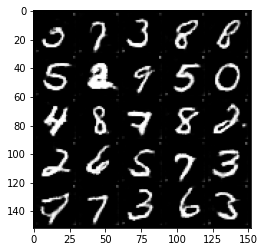

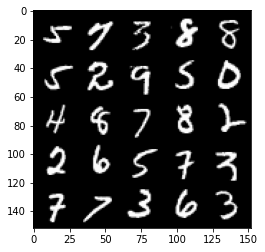

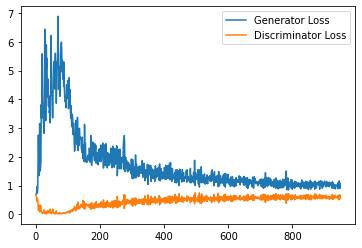

Step 19500: Generator loss: 1.0116958671808243, discriminator loss: 0.5928124996423721


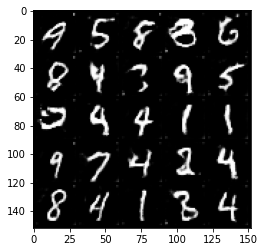

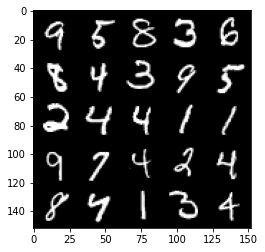

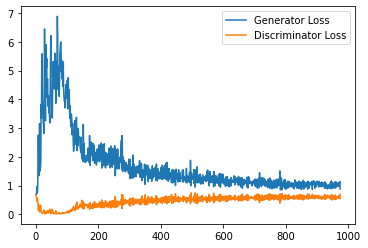

Step 20000: Generator loss: 1.0117368887662888, discriminator loss: 0.5920368937849998


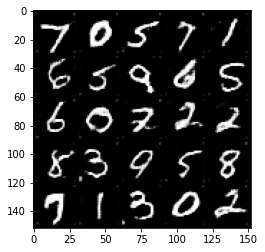

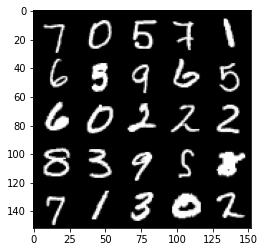

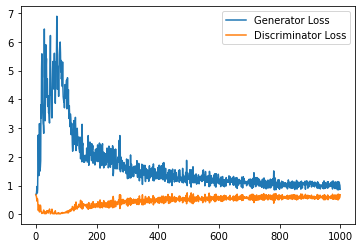

Step 20500: Generator loss: 0.9956343079805374, discriminator loss: 0.5930650494098664


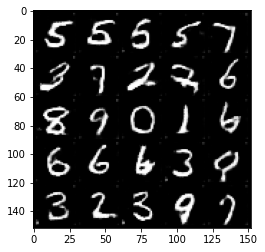

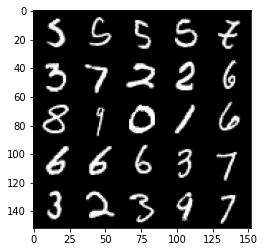

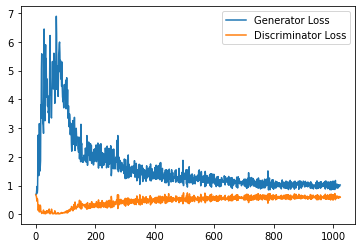

Step 21000: Generator loss: 1.0222349803447723, discriminator loss: 0.5965967563390732


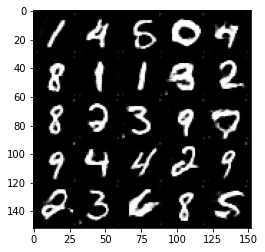

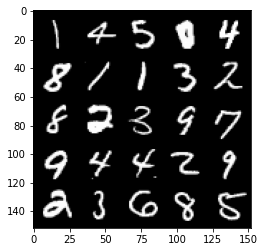

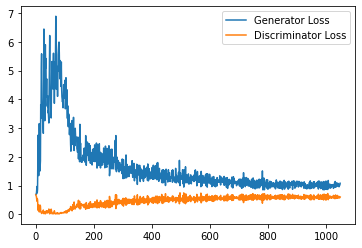

Step 21500: Generator loss: 0.9808341493606567, discriminator loss: 0.5977212449908257


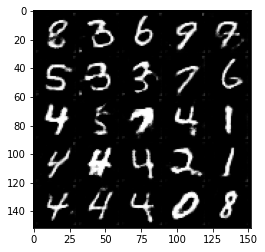

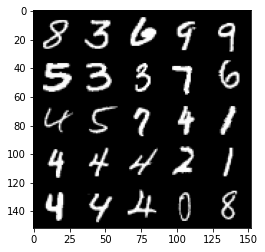

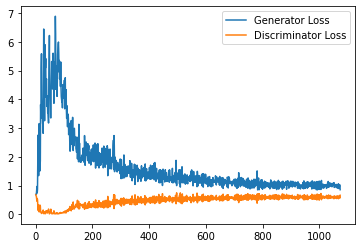

Step 22000: Generator loss: 0.9863806371688842, discriminator loss: 0.5954870913028717


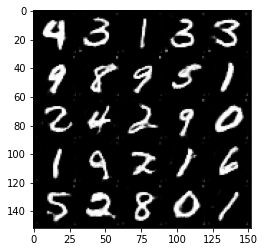

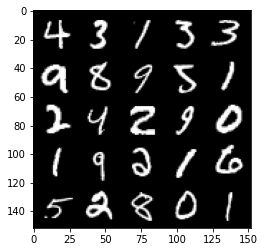

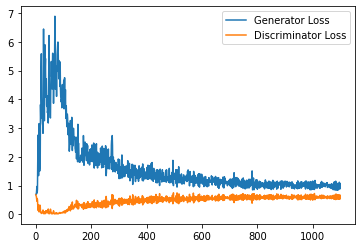

Step 22500: Generator loss: 0.9889788228273392, discriminator loss: 0.5960855495929718


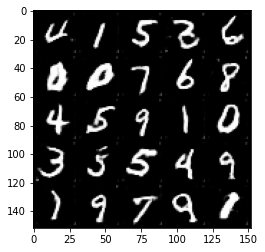

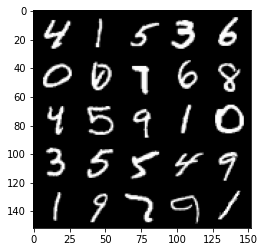

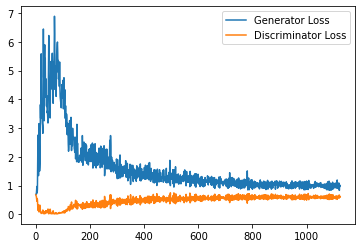

Step 23000: Generator loss: 0.9829741504192352, discriminator loss: 0.6022200329899788


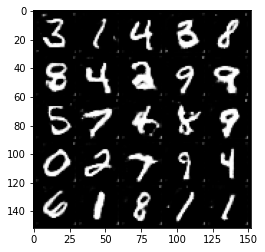

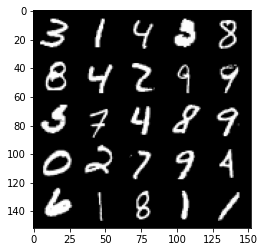

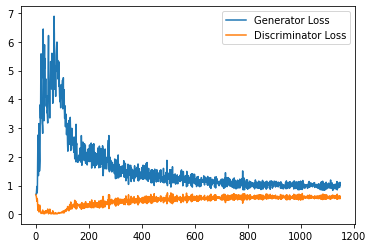

Step 23500: Generator loss: 1.015023209452629, discriminator loss: 0.5980219593048096


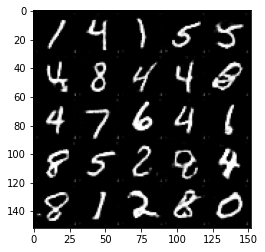

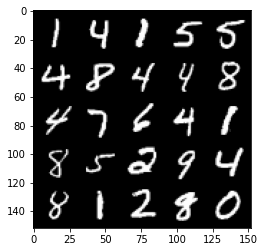

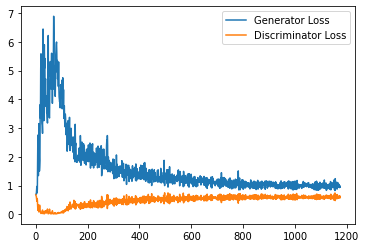

Step 24000: Generator loss: 0.9857470964193344, discriminator loss: 0.602397256731987


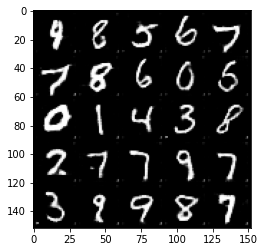

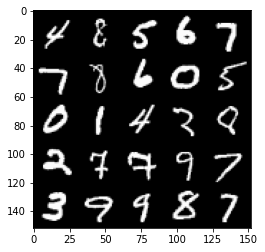

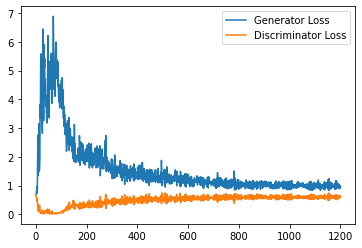

Step 24500: Generator loss: 0.9876630510091782, discriminator loss: 0.5988216211795807


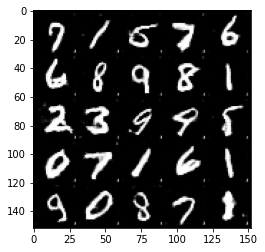

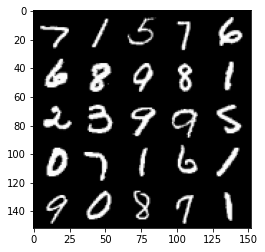

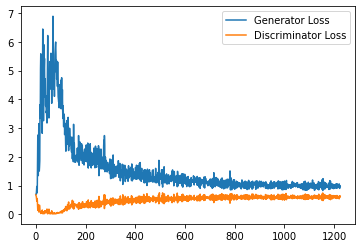

Step 25000: Generator loss: 0.9888837985992431, discriminator loss: 0.5991305078864098


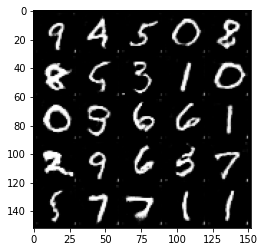

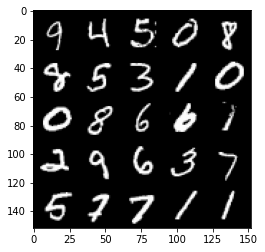

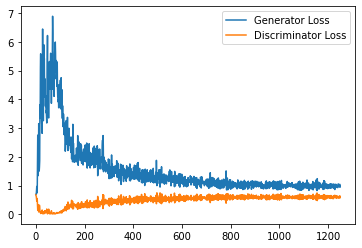

Step 25500: Generator loss: 0.9949914504289628, discriminator loss: 0.5973430004119873


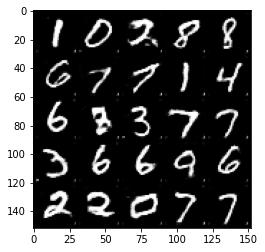

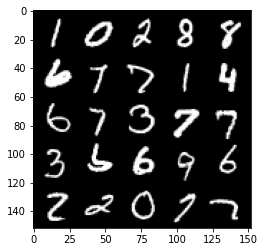

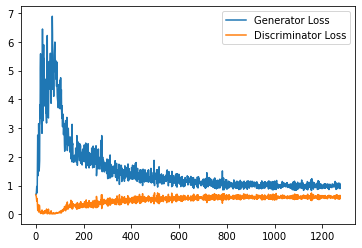

Step 26000: Generator loss: 0.9917613912820816, discriminator loss: 0.5960688430070877


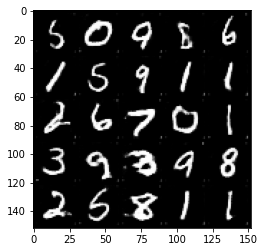

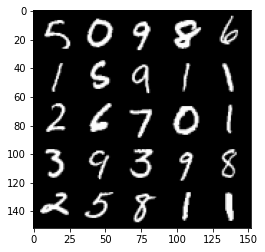

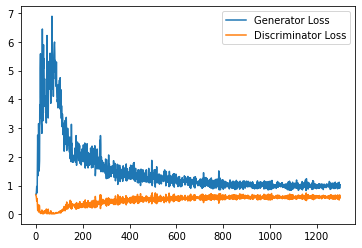

Step 26500: Generator loss: 0.9875492217540741, discriminator loss: 0.5938037193417549


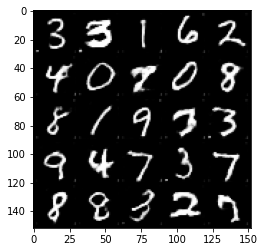

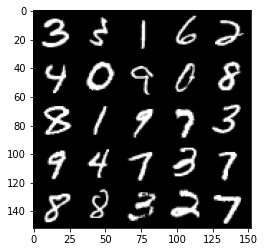

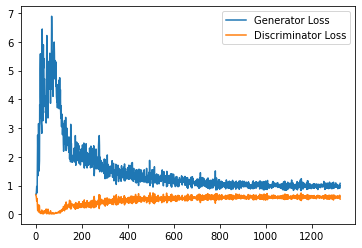

Step 27000: Generator loss: 0.9860749472379684, discriminator loss: 0.5997161453962326


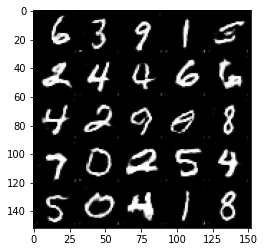

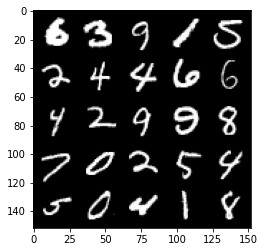

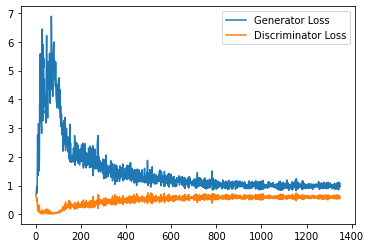

Step 27500: Generator loss: 0.9850877331495285, discriminator loss: 0.6038732701539993


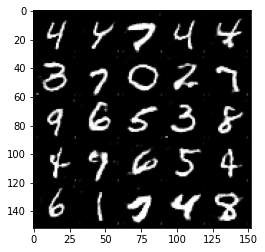

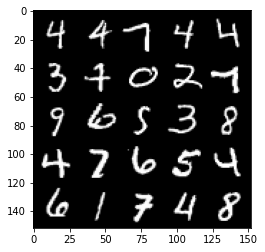

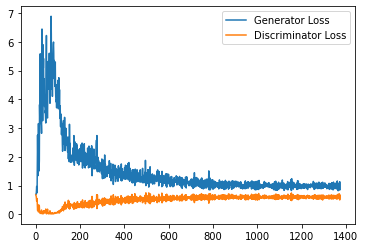

Step 28000: Generator loss: 0.9789771758317948, discriminator loss: 0.5955582324266434


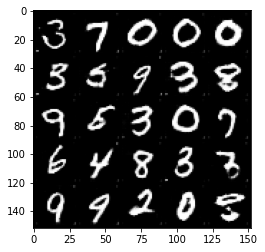

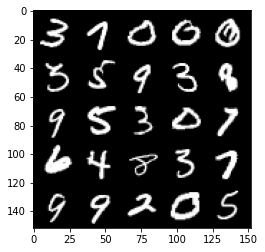

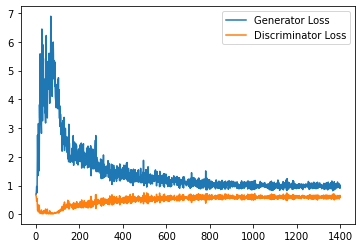

Step 28500: Generator loss: 0.9885588755607605, discriminator loss: 0.5936618029475212


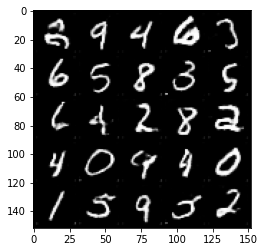

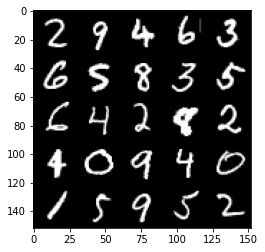

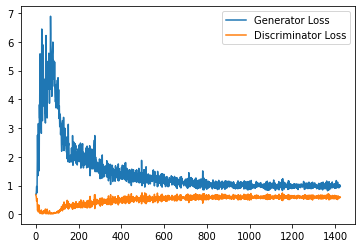

Step 29000: Generator loss: 0.9788978854417801, discriminator loss: 0.5981939125657082


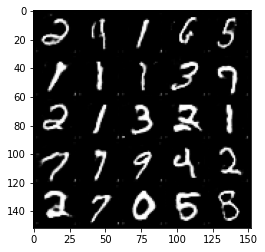

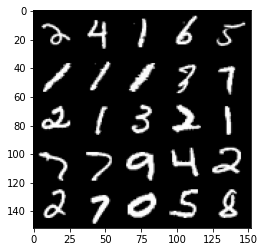

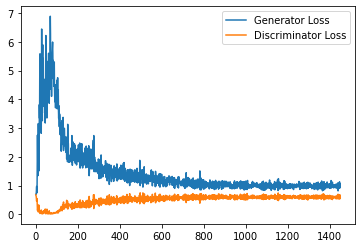

Step 29500: Generator loss: 0.9701846915483475, discriminator loss: 0.5995566084384918


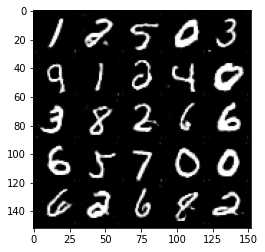

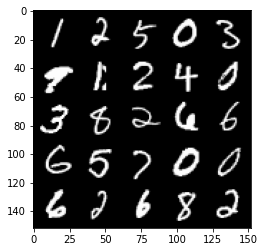

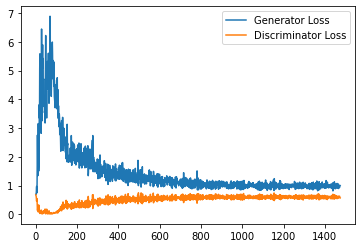

Step 30000: Generator loss: 0.9717881619930268, discriminator loss: 0.60175269562006


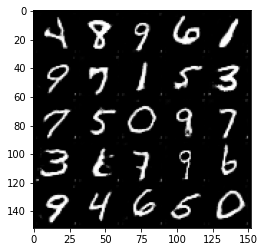

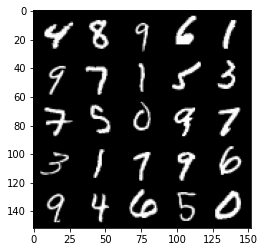

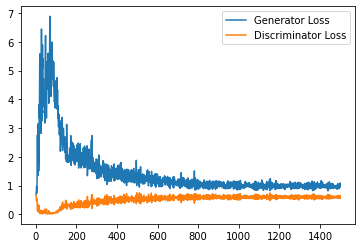

Step 30500: Generator loss: 0.9913799868822097, discriminator loss: 0.5989908546209335


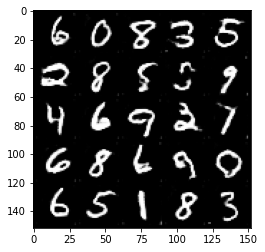

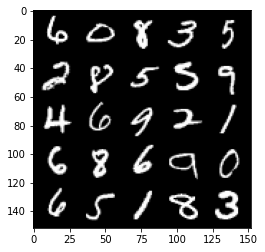

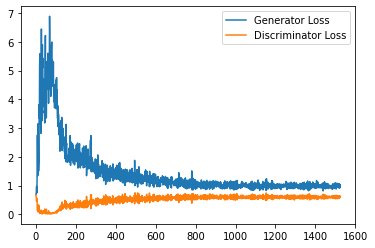

Step 31000: Generator loss: 0.9630869126319885, discriminator loss: 0.5998439806699752


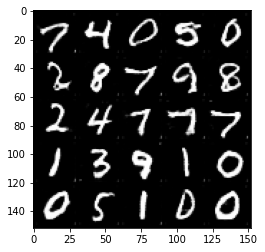

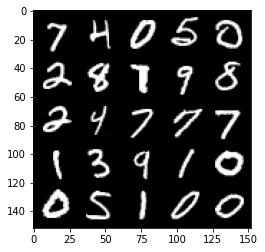

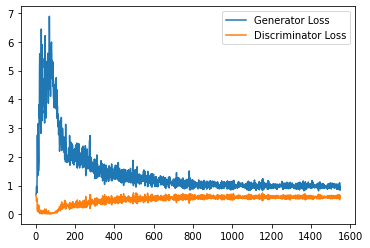

Step 31500: Generator loss: 0.9609806342124939, discriminator loss: 0.6009015216827392


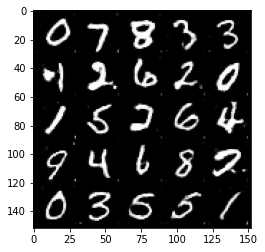

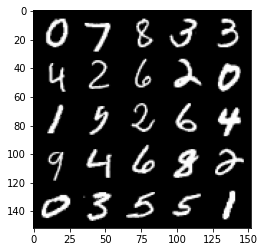

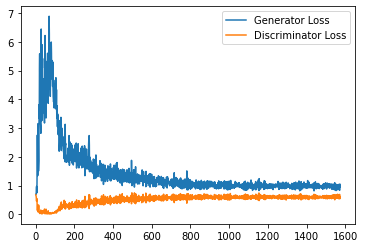

Step 32000: Generator loss: 0.9757631603479385, discriminator loss: 0.6008504251241684


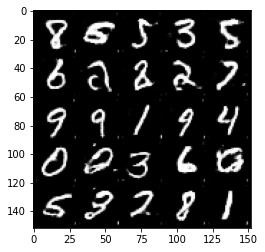

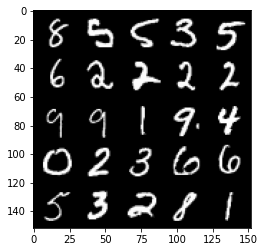

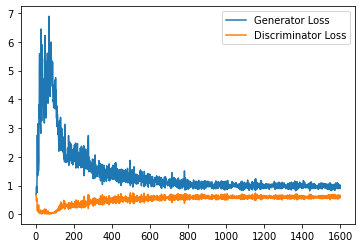

Step 32500: Generator loss: 0.9816330606937409, discriminator loss: 0.6013469133973122


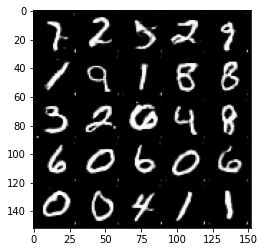

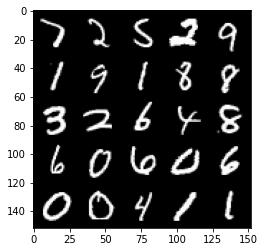

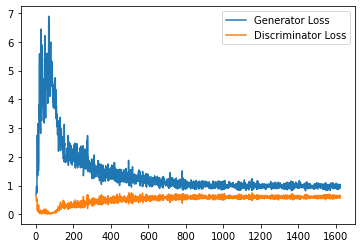

Step 33000: Generator loss: 0.9730600616931915, discriminator loss: 0.6030387792587281


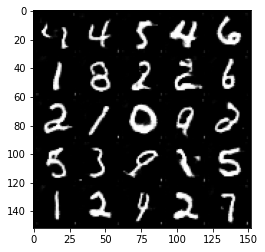

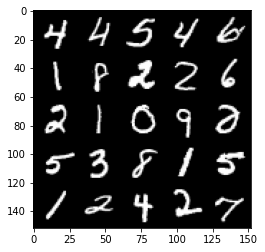

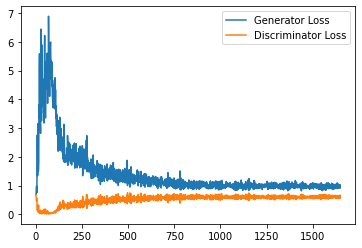

Step 33500: Generator loss: 0.9609262036085129, discriminator loss: 0.6030437716841698


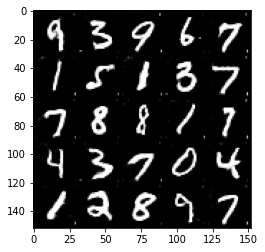

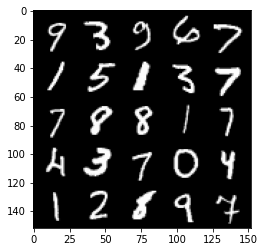

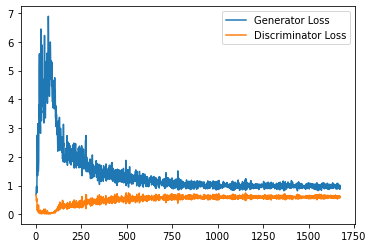

Step 34000: Generator loss: 0.9477394425868988, discriminator loss: 0.6088431634306908


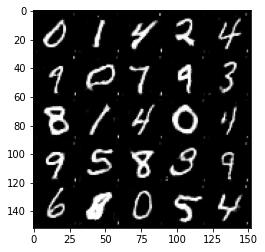

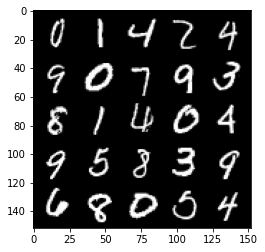

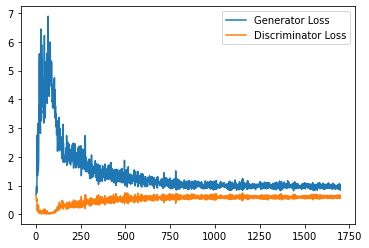

Step 34500: Generator loss: 0.9703987300395965, discriminator loss: 0.6020727658867836


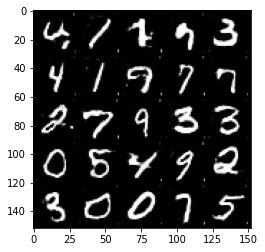

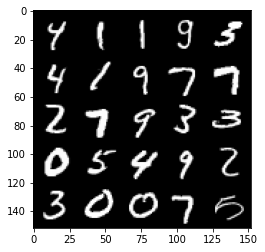

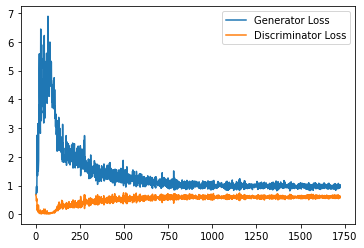

Step 35000: Generator loss: 0.9542750904560089, discriminator loss: 0.6065104762315751


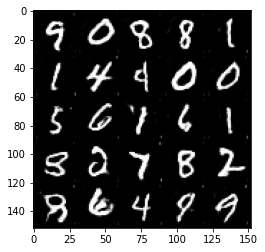

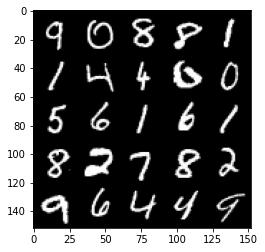

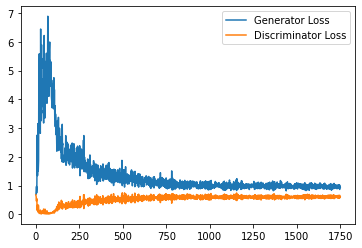

Step 35500: Generator loss: 0.945130630493164, discriminator loss: 0.6034611241817475


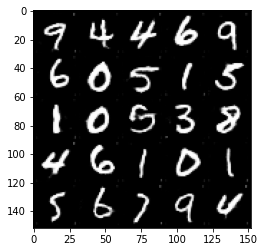

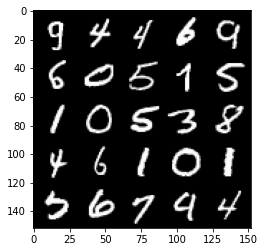

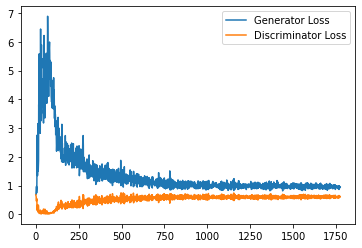

Step 36000: Generator loss: 0.9627105040550232, discriminator loss: 0.6014614863395691


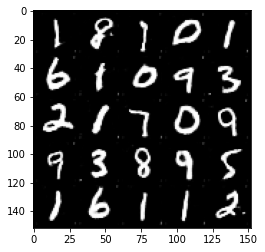

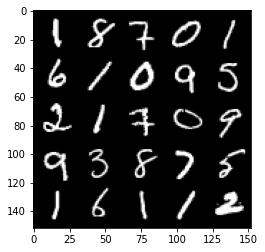

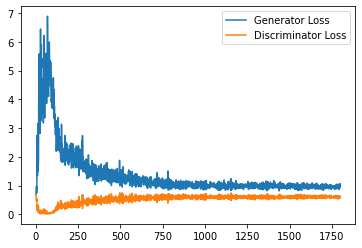

Step 36500: Generator loss: 0.9809566112756729, discriminator loss: 0.6045153369307518


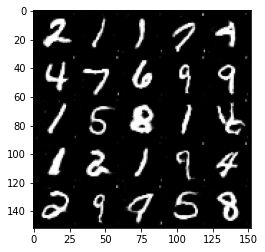

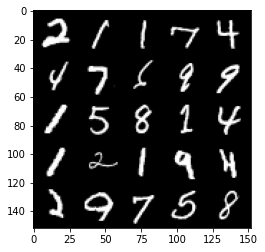

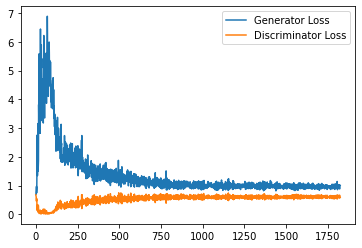

Step 37000: Generator loss: 0.9653049299716949, discriminator loss: 0.6043073556423187


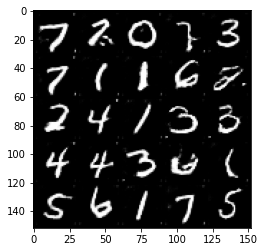

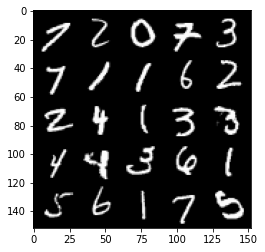

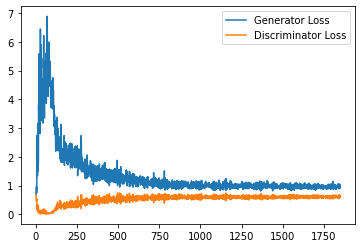

Step 37500: Generator loss: 0.9925190286636353, discriminator loss: 0.6065828938484192


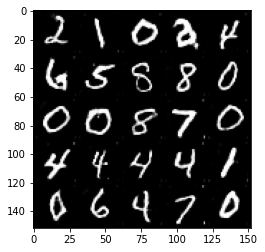

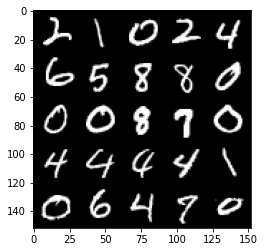

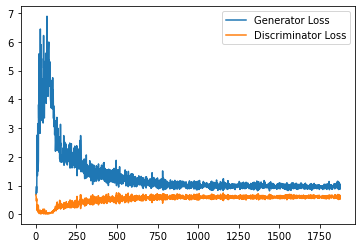

Step 38000: Generator loss: 0.9402129518985748, discriminator loss: 0.6106807590723038


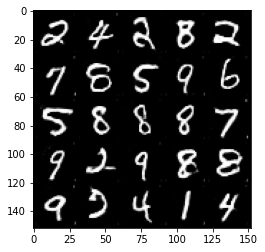

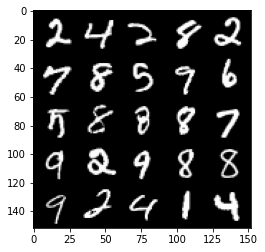

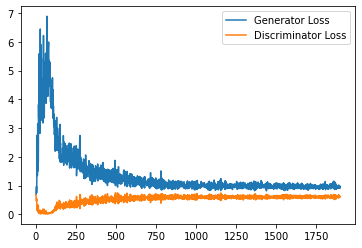

Step 38500: Generator loss: 0.9464859365224838, discriminator loss: 0.6099600123167038


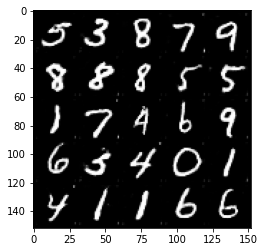

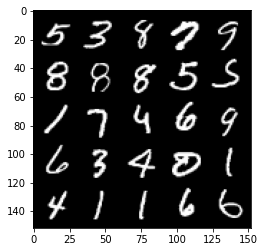

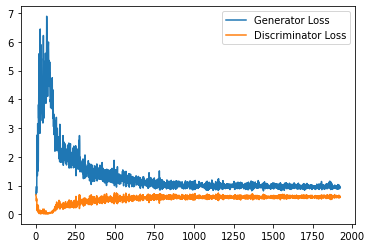

Step 39000: Generator loss: 0.9437949728965759, discriminator loss: 0.604759825527668


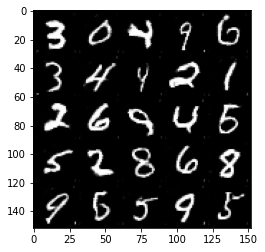

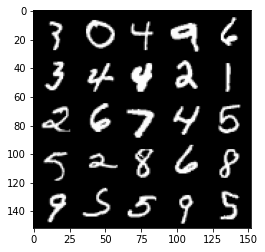

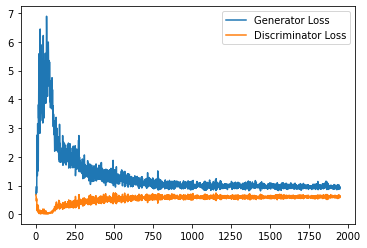

Step 39500: Generator loss: 0.9570032514333725, discriminator loss: 0.6053516204357148


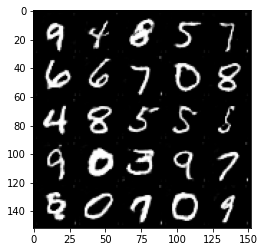

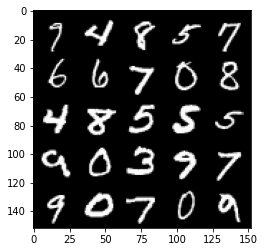

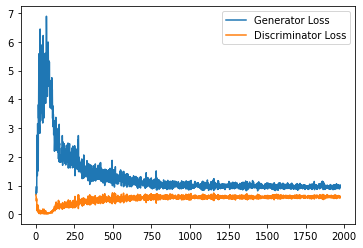

Step 40000: Generator loss: 0.9682070206403732, discriminator loss: 0.6061524786949157


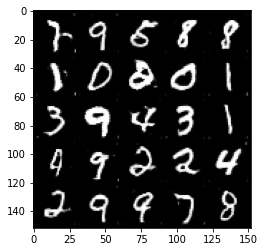

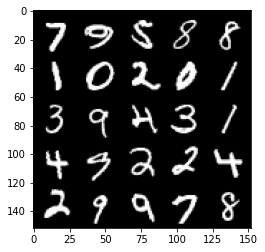

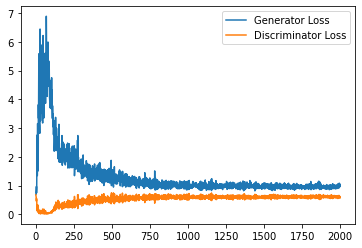

Step 40500: Generator loss: 0.9745091689825058, discriminator loss: 0.6081993247270584


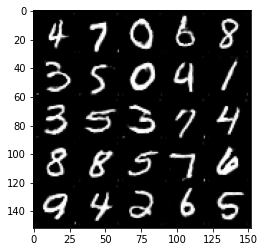

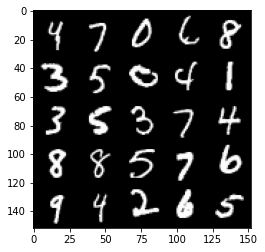

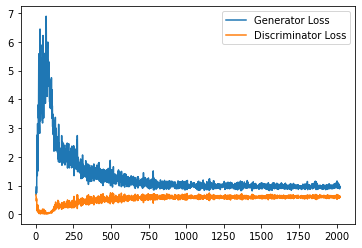

Step 41000: Generator loss: 0.9398061803579331, discriminator loss: 0.6062988673448563


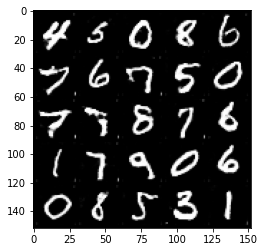

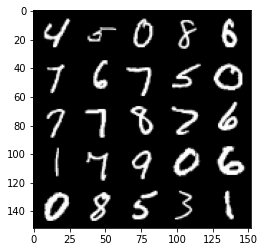

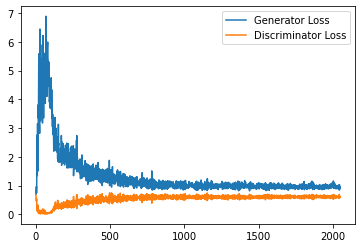

Step 41500: Generator loss: 0.9747609930038452, discriminator loss: 0.6083274331092835


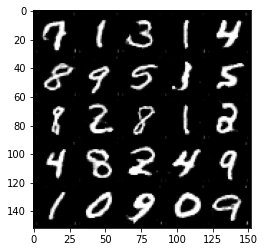

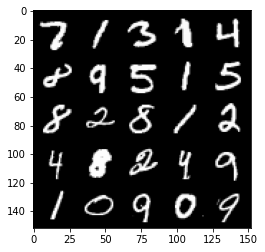

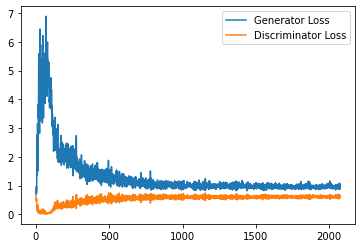

Step 42000: Generator loss: 0.9578711969852447, discriminator loss: 0.6030371694564819


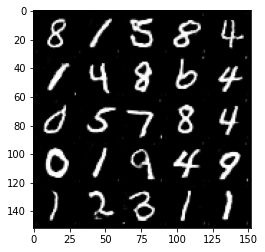

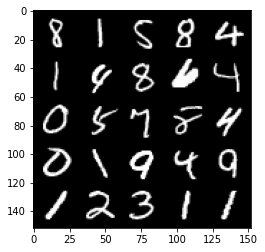

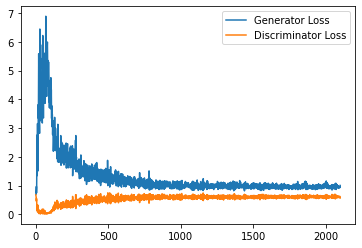

Step 42500: Generator loss: 0.9738539432287217, discriminator loss: 0.6056566728353501


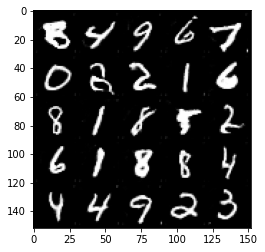

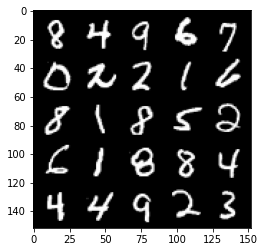

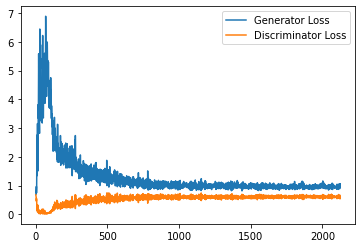

Step 43000: Generator loss: 0.9660244203805923, discriminator loss: 0.6084216324090957


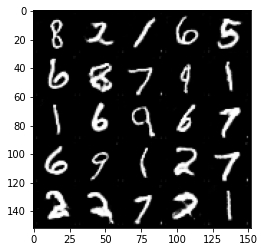

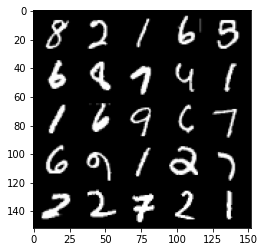

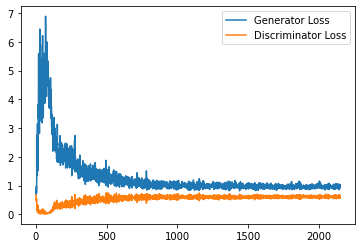

Step 43500: Generator loss: 0.9563096550703049, discriminator loss: 0.6104054923653602


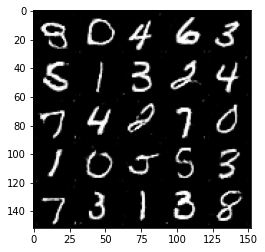

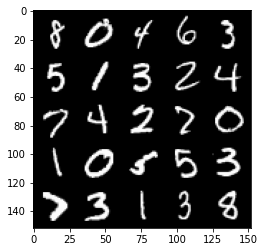

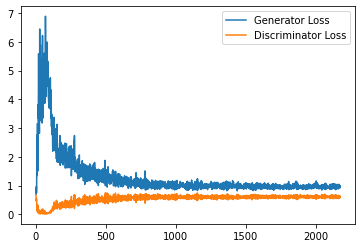

Step 44000: Generator loss: 0.9809801963567734, discriminator loss: 0.613389524936676


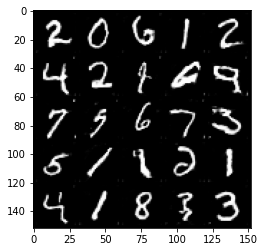

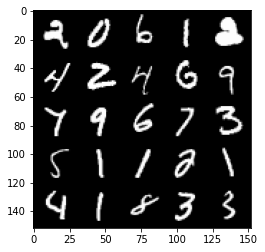

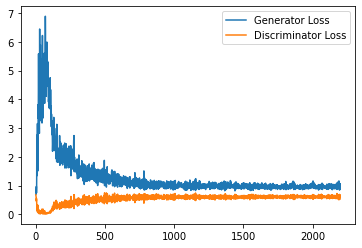

Step 44500: Generator loss: 0.944272199511528, discriminator loss: 0.6200638623833656


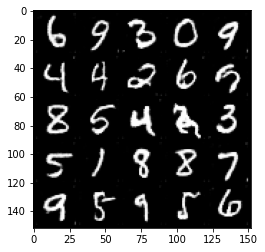

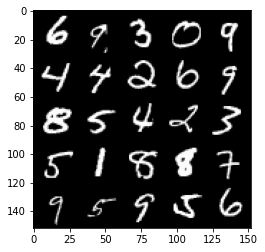

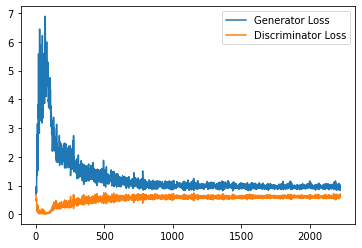

Step 45000: Generator loss: 0.9485391863584518, discriminator loss: 0.6087685135602952


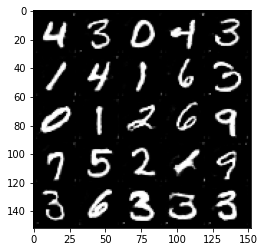

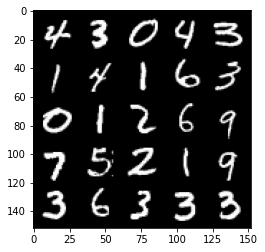

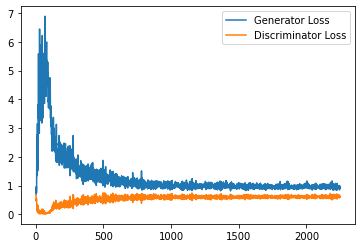

Step 45500: Generator loss: 0.9490511583089829, discriminator loss: 0.6103787678480148


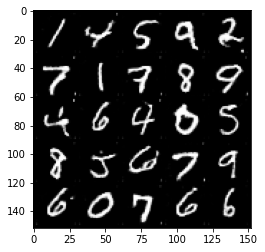

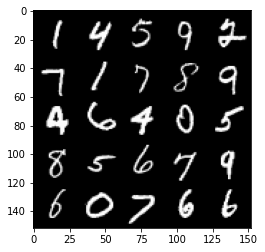

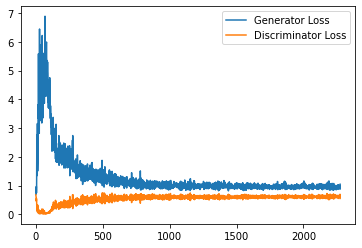

Step 46000: Generator loss: 0.972432477414608, discriminator loss: 0.6179996420145035


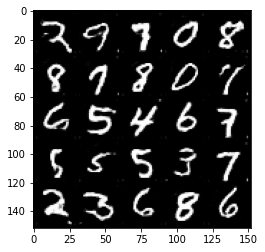

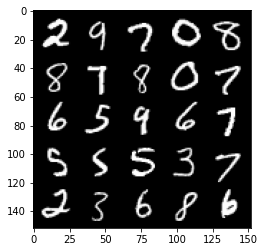

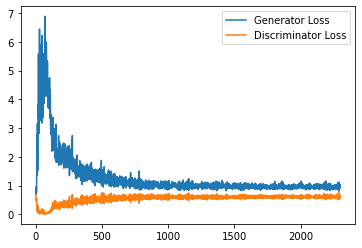

Step 46500: Generator loss: 0.9585008418560028, discriminator loss: 0.612724347114563


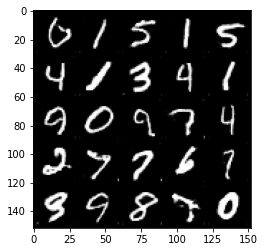

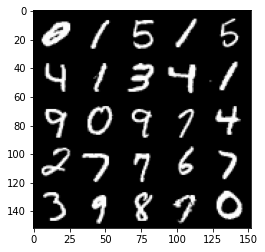

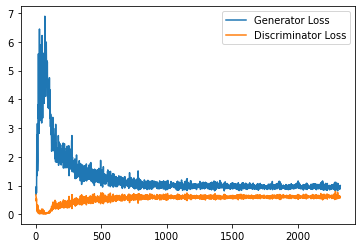

Step 47000: Generator loss: 0.9397194949388504, discriminator loss: 0.6136446657180786


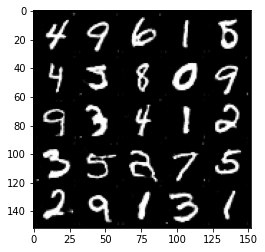

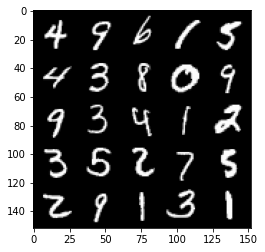

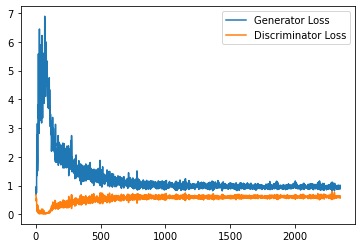

Step 47500: Generator loss: 0.9563435908555985, discriminator loss: 0.6121620804667472


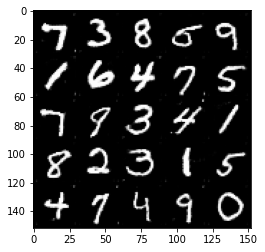

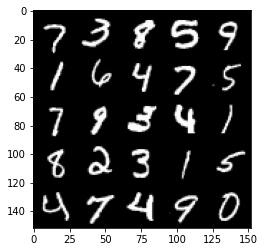

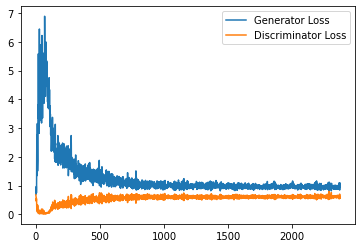

Step 48000: Generator loss: 0.9839474160671234, discriminator loss: 0.6140861203670501


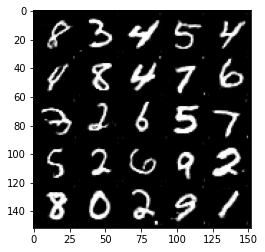

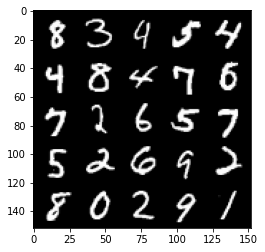

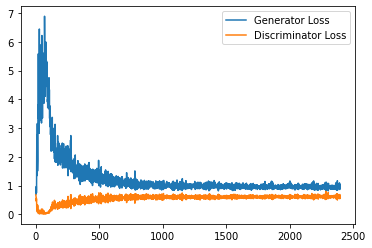

Step 48500: Generator loss: 0.9414319798946381, discriminator loss: 0.6126853942871093


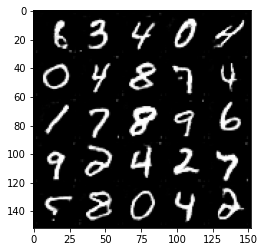

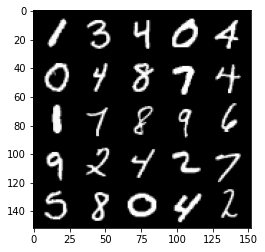

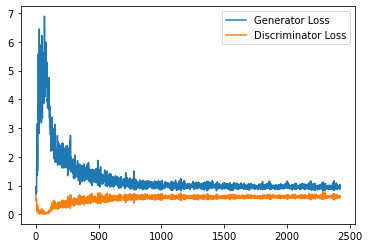

Step 49000: Generator loss: 0.9552262104749679, discriminator loss: 0.6195116183161735


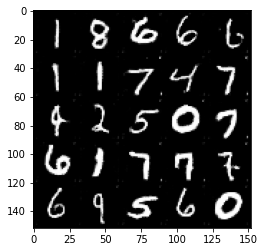

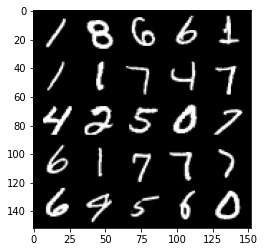

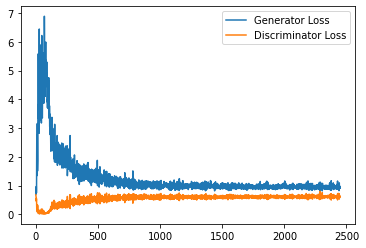

Step 49500: Generator loss: 0.9383772498369217, discriminator loss: 0.6171565135121345


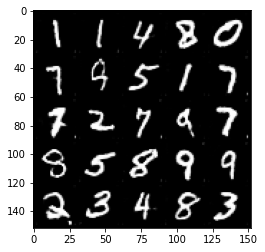

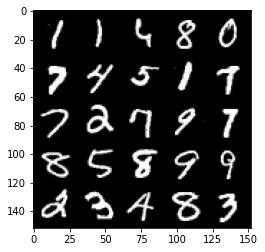

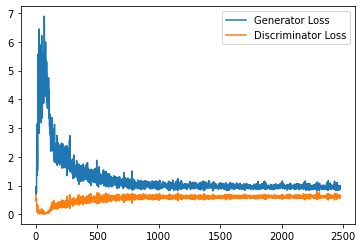

Step 50000: Generator loss: 0.9379854260683059, discriminator loss: 0.6121756955385208


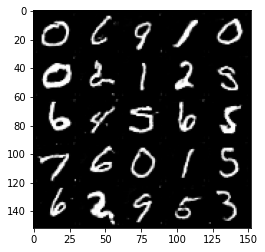

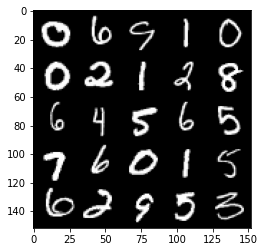

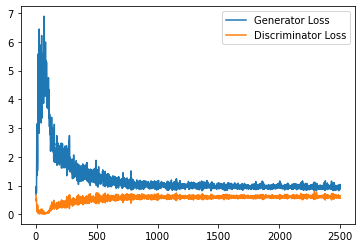

Step 50500: Generator loss: 0.9623073271512985, discriminator loss: 0.6159369367361068


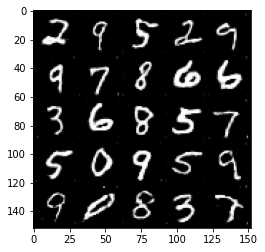

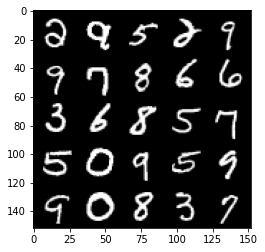

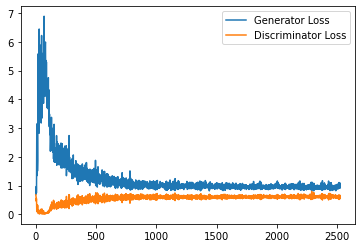

Step 51000: Generator loss: 0.9459118421077728, discriminator loss: 0.6154979839324951


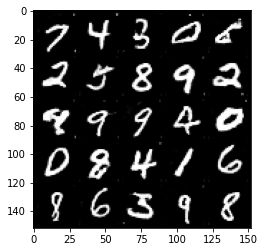

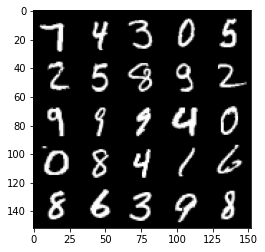

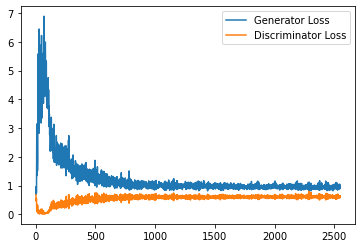

Step 51500: Generator loss: 0.9491040964126587, discriminator loss: 0.6153346458077431


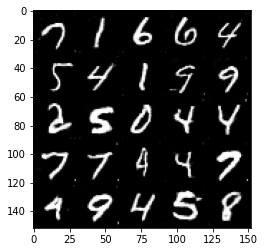

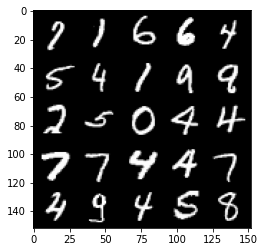

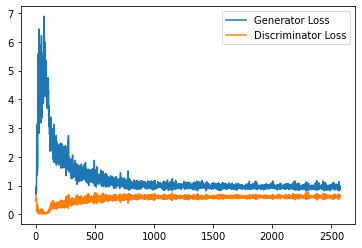

Step 52000: Generator loss: 0.9274466240406036, discriminator loss: 0.6175263242125512


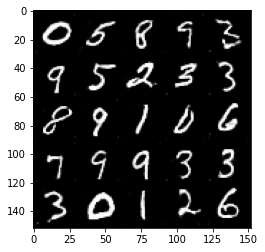

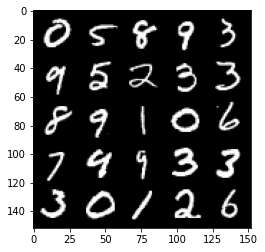

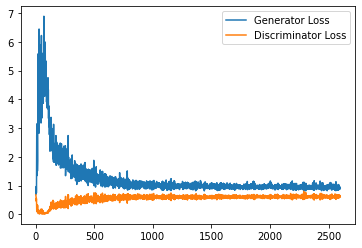

Step 52500: Generator loss: 0.9483716881275177, discriminator loss: 0.6165750036239624


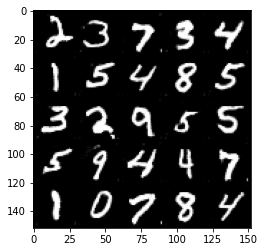

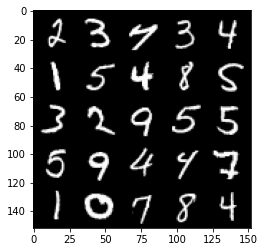

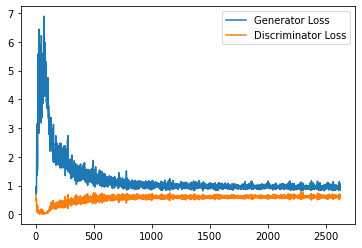

Step 53000: Generator loss: 0.9517143226861954, discriminator loss: 0.6198967884778976


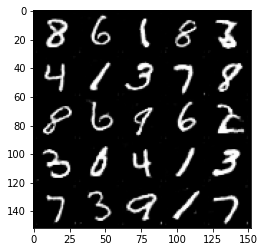

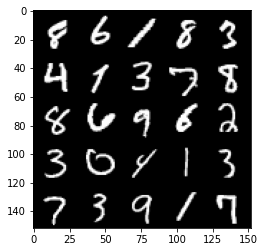

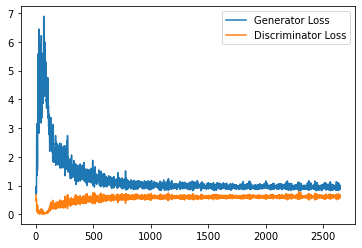

Step 53500: Generator loss: 0.9299799911379815, discriminator loss: 0.6195144530534744


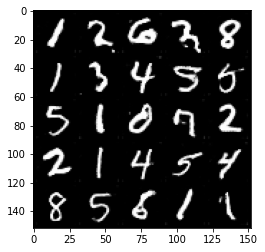

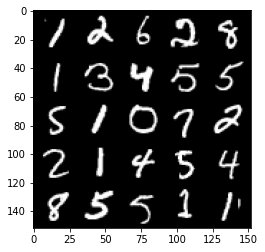

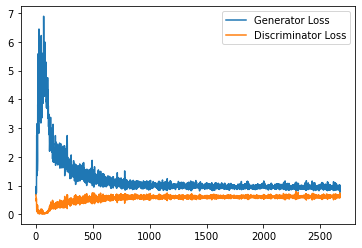

Step 54000: Generator loss: 0.9367743501663208, discriminator loss: 0.6187616966962814


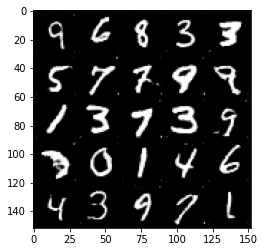

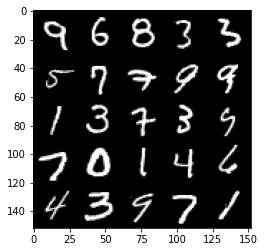

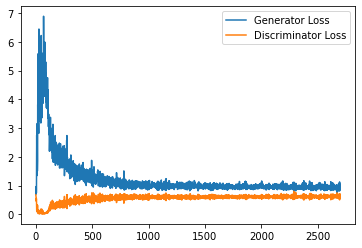

Step 54500: Generator loss: 0.9375411461591721, discriminator loss: 0.6200119128227234


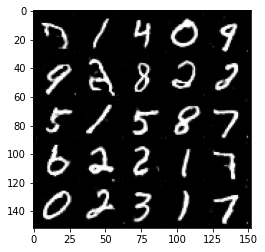

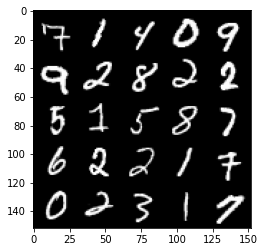

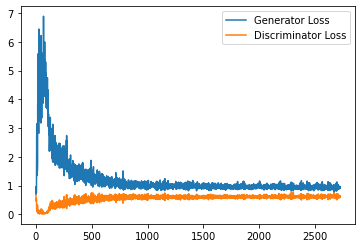

Step 55000: Generator loss: 0.9356888506412506, discriminator loss: 0.619464848279953


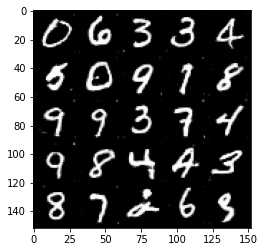

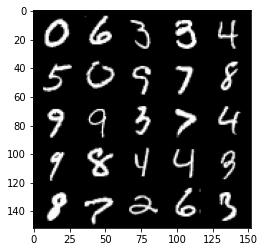

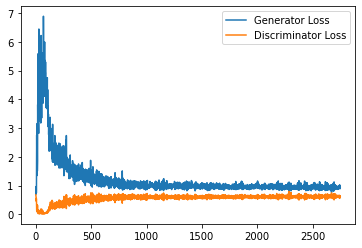

Step 55500: Generator loss: 0.9512406496405601, discriminator loss: 0.6261232971549034


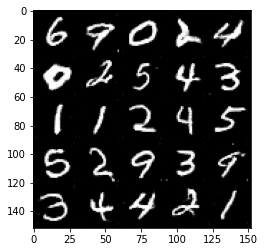

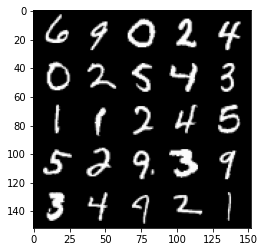

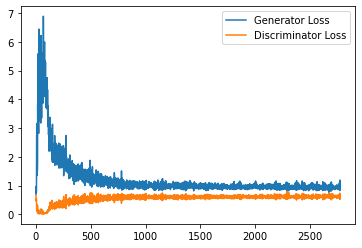

Step 56000: Generator loss: 0.9364831030368805, discriminator loss: 0.6159946476221084


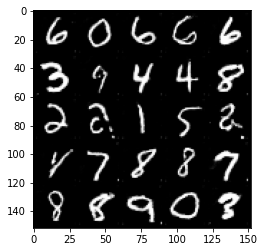

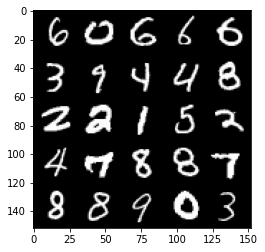

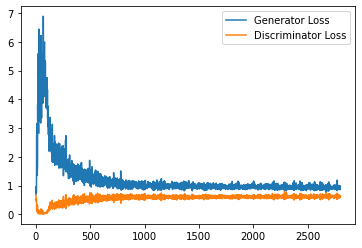

Step 56500: Generator loss: 0.9445042600631713, discriminator loss: 0.6213940213918686


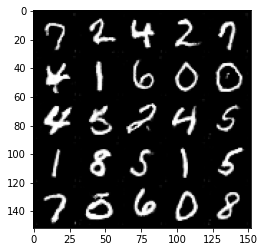

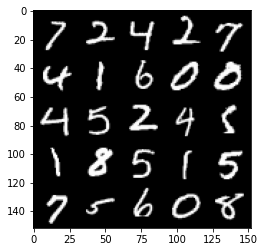

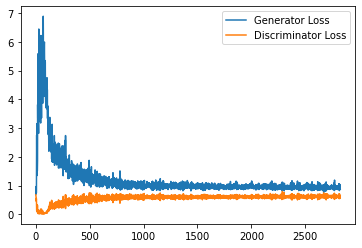

Step 57000: Generator loss: 0.9475738899707794, discriminator loss: 0.6179274113178254


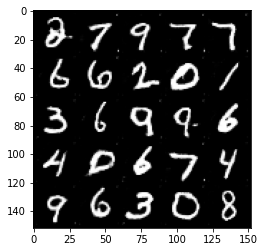

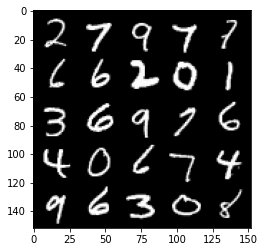

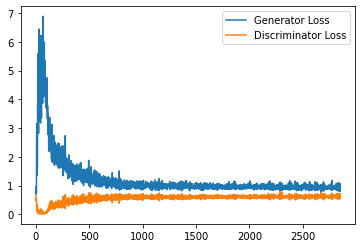

Step 57500: Generator loss: 0.9385471198558807, discriminator loss: 0.618568031668663


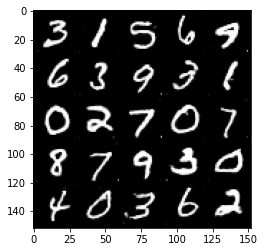

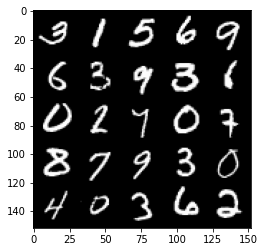

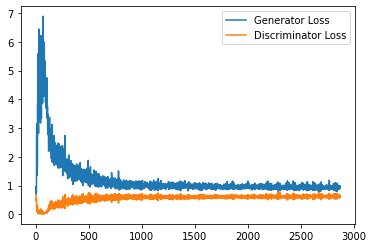

Step 58000: Generator loss: 0.9408234589099884, discriminator loss: 0.6158179368376732


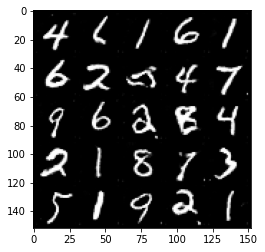

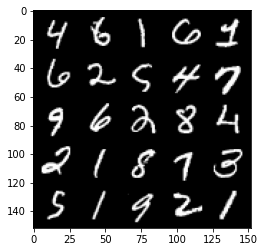

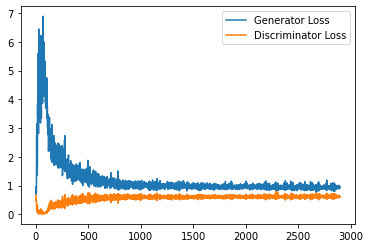

Step 58500: Generator loss: 0.930670424580574, discriminator loss: 0.6243754948973655


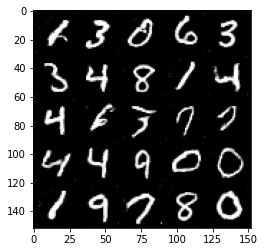

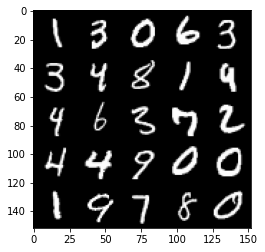

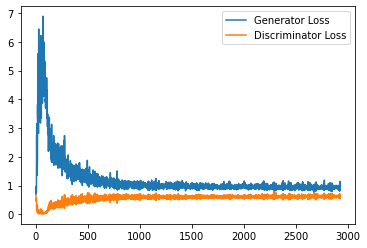

Step 59000: Generator loss: 0.9247987915277481, discriminator loss: 0.625076329946518


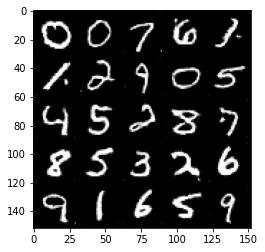

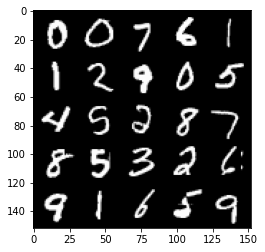

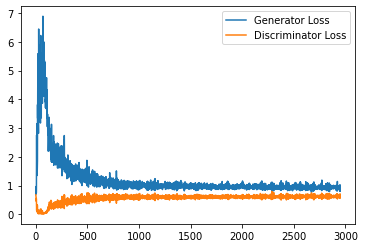

Step 59500: Generator loss: 0.9560515240430832, discriminator loss: 0.6183100054860116


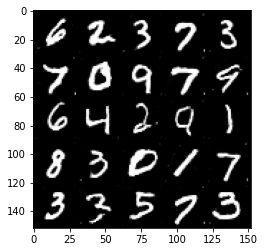

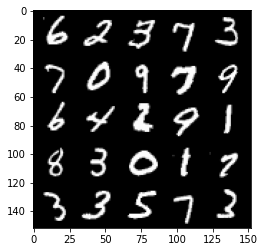

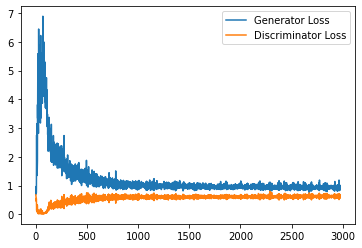

Step 60000: Generator loss: 0.9312920624017715, discriminator loss: 0.6271628860831261


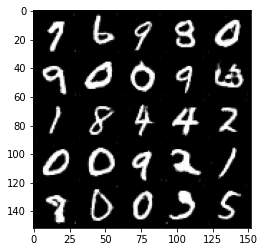

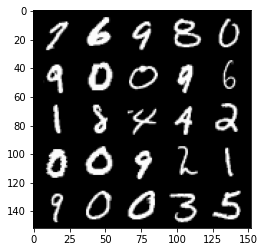

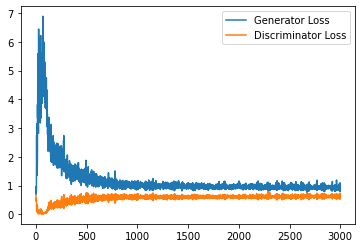

Step 60500: Generator loss: 0.9376977533102036, discriminator loss: 0.6222409957051277


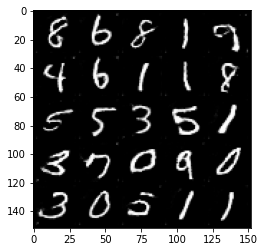

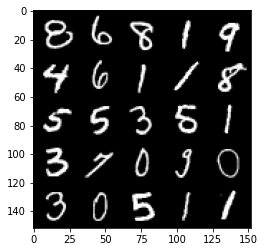

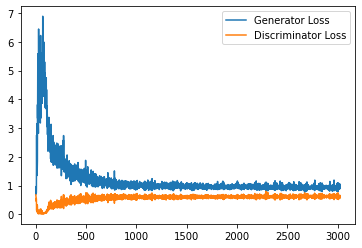

Step 61000: Generator loss: 0.9327774748802186, discriminator loss: 0.6277308884859085


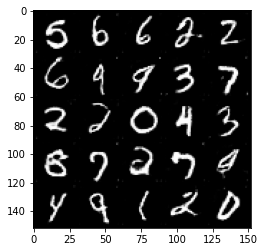

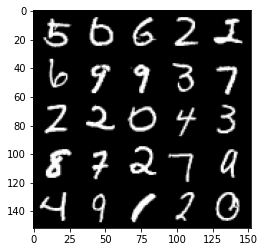

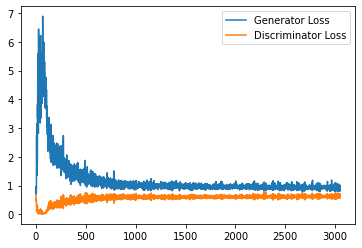

Step 61500: Generator loss: 0.9397522013187408, discriminator loss: 0.6232624274492263


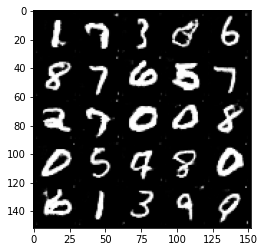

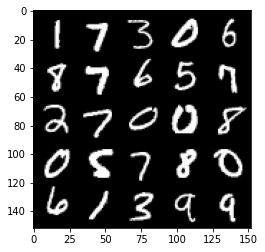

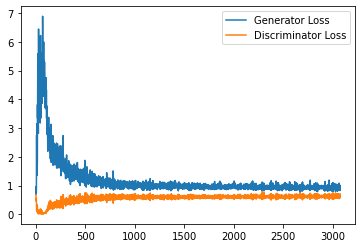

Step 62000: Generator loss: 0.9234679354429245, discriminator loss: 0.6209154003858566


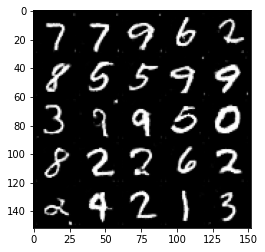

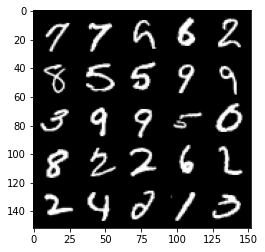

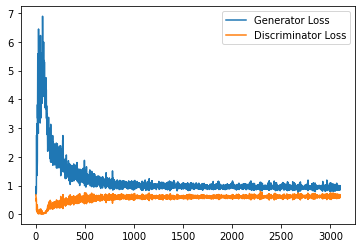

Step 62500: Generator loss: 0.9264808111190795, discriminator loss: 0.6245923840403557


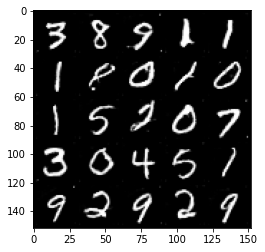

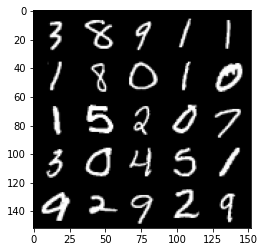

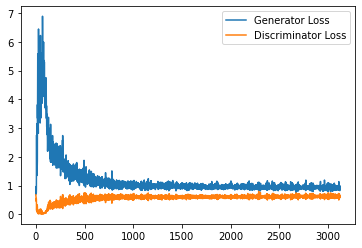

Step 63000: Generator loss: 0.9248921465873718, discriminator loss: 0.6247867679595948


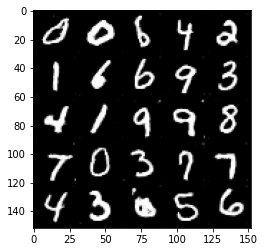

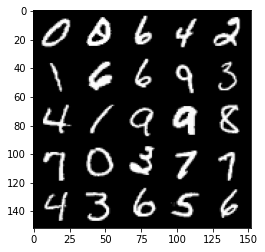

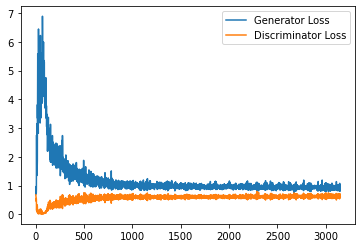

Step 63500: Generator loss: 0.9374781966209411, discriminator loss: 0.6253686824440956


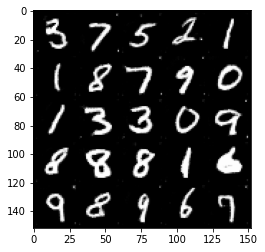

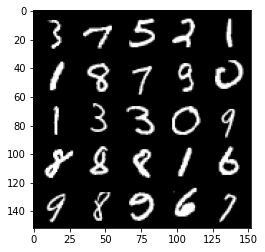

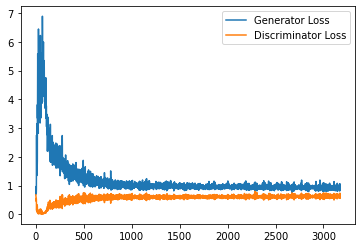

Step 64000: Generator loss: 0.934645364522934, discriminator loss: 0.6214704408049584


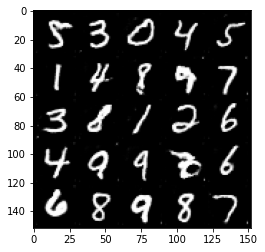

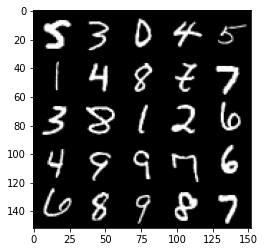

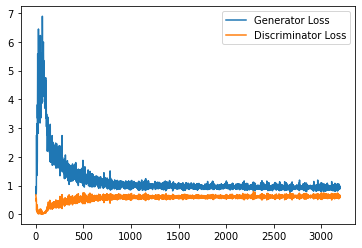

Step 64500: Generator loss: 0.9214369612932205, discriminator loss: 0.6245020532011986


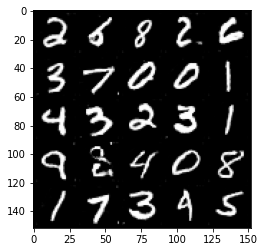

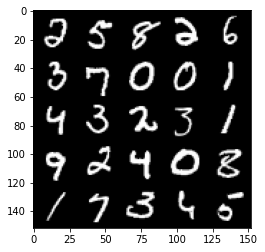

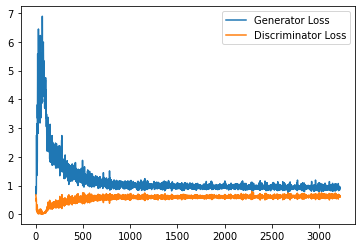

Step 65000: Generator loss: 0.9149373118877411, discriminator loss: 0.6191621896028519


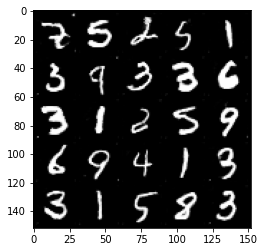

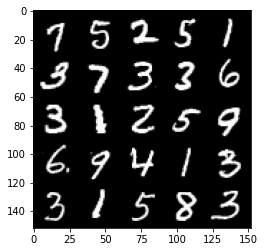

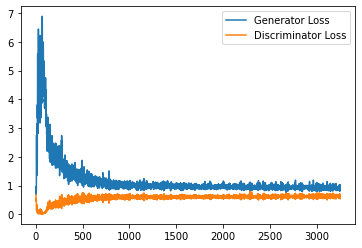

Step 65500: Generator loss: 0.9236128504276275, discriminator loss: 0.6300786854624748


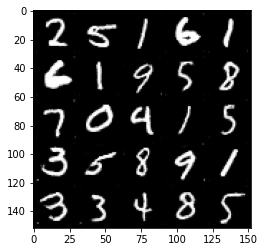

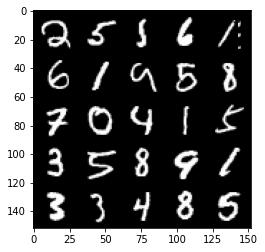

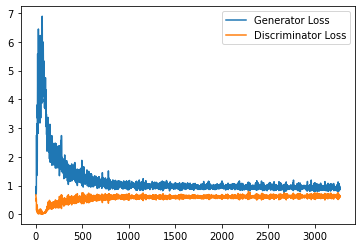

Step 66000: Generator loss: 0.9332219758033753, discriminator loss: 0.6242569732666016


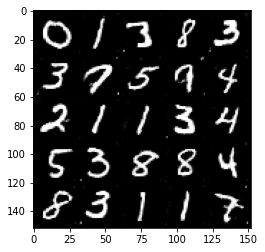

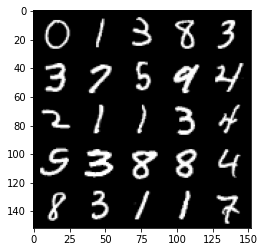

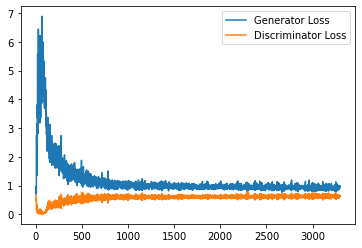

Step 66500: Generator loss: 0.9311080888509751, discriminator loss: 0.627605353474617


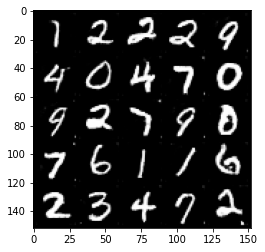

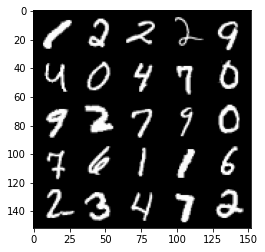

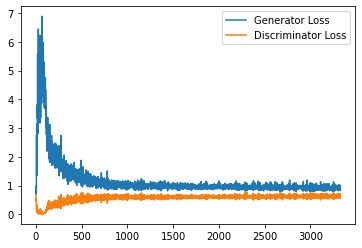

Step 67000: Generator loss: 0.9237319420576096, discriminator loss: 0.6269341394901276


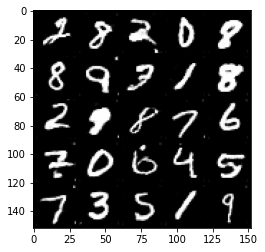

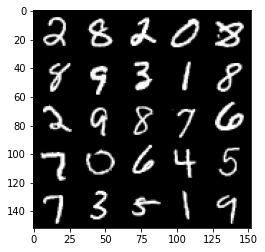

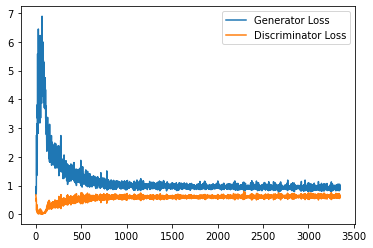

Step 67500: Generator loss: 0.9235823893547058, discriminator loss: 0.6279968214631081


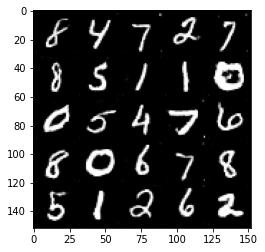

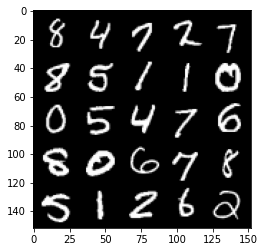

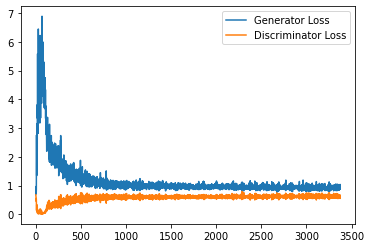

Step 68000: Generator loss: 0.9295429900884629, discriminator loss: 0.6257893759608268


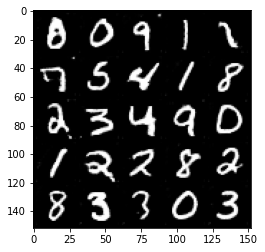

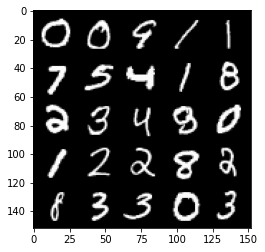

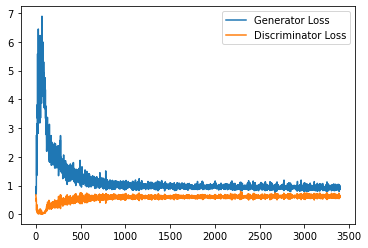

Step 68500: Generator loss: 0.9391264075040817, discriminator loss: 0.6236565243005753


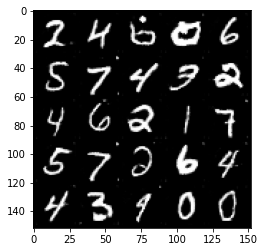

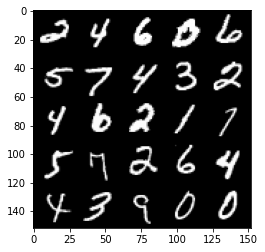

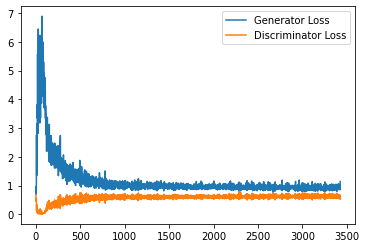

Step 69000: Generator loss: 0.9155707112550735, discriminator loss: 0.6268311712741852


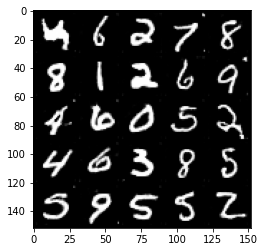

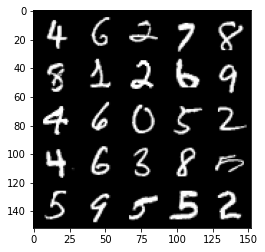

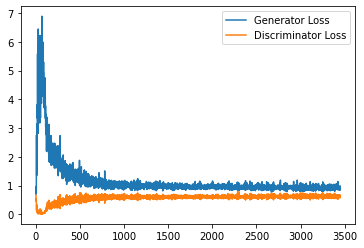

Step 69500: Generator loss: 0.9260727670192719, discriminator loss: 0.6356176104545593


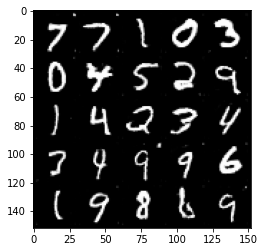

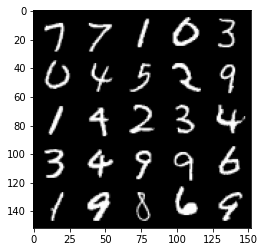

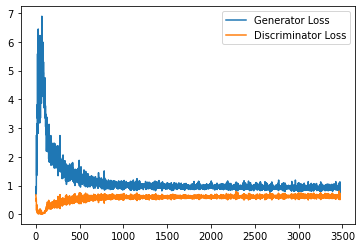

Step 70000: Generator loss: 0.9374420533180237, discriminator loss: 0.6269542910456657


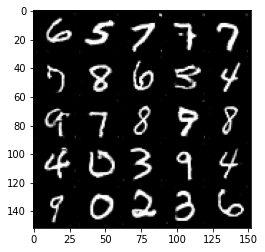

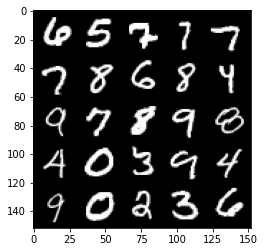

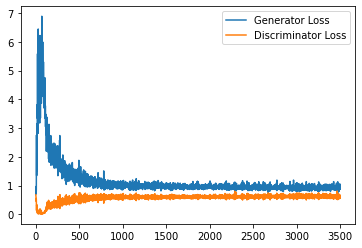

Step 70500: Generator loss: 0.9157828433513642, discriminator loss: 0.6313292524218559


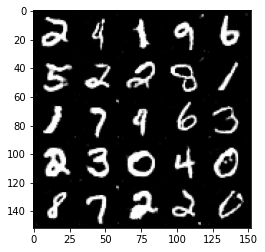

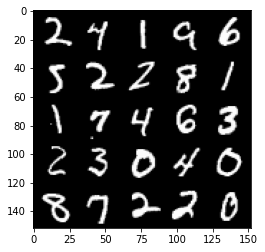

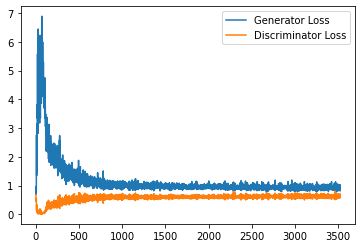

Step 71000: Generator loss: 0.9340696543455124, discriminator loss: 0.6246302088499069


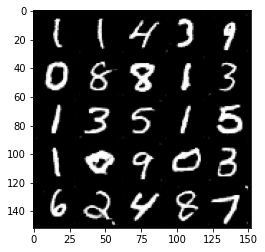

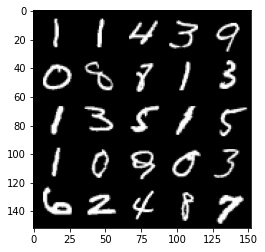

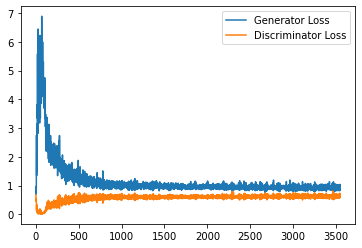

Step 71500: Generator loss: 0.9327913975715637, discriminator loss: 0.6278805669546127


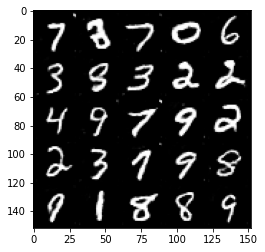

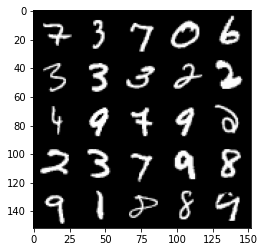

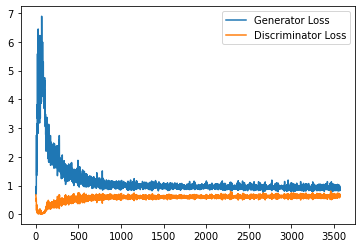

Step 72000: Generator loss: 0.9077212297916413, discriminator loss: 0.6308766357898712


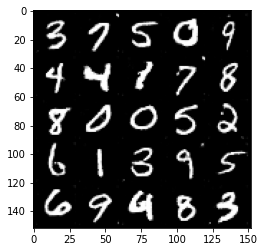

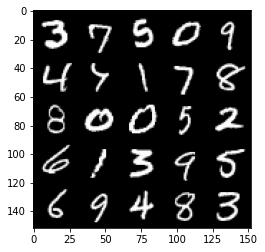

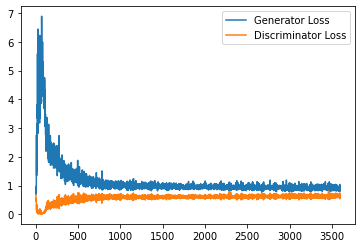

Step 72500: Generator loss: 0.9030004757642746, discriminator loss: 0.6322017380595207


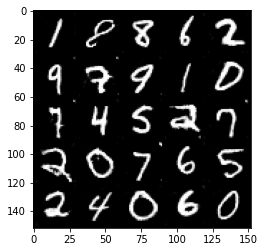

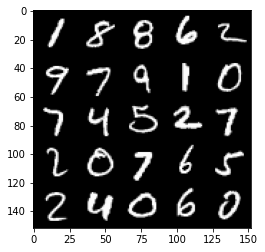

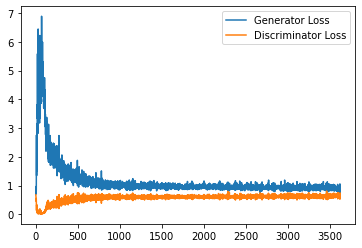

Step 73000: Generator loss: 0.9055230028629303, discriminator loss: 0.6272403672933579


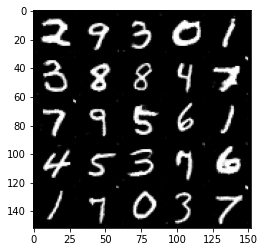

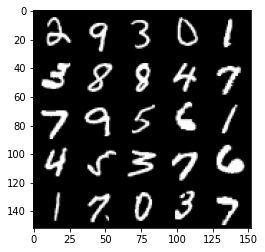

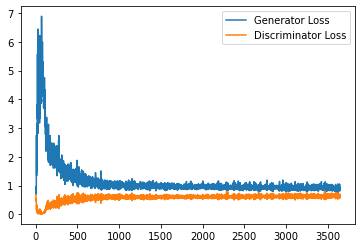

Step 73500: Generator loss: 0.9208087161779404, discriminator loss: 0.6285004806518555


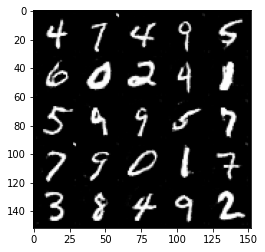

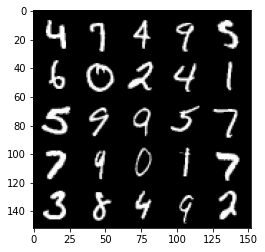

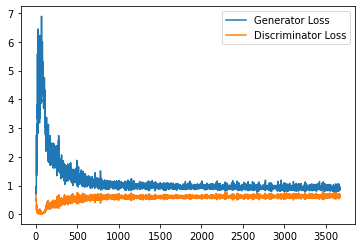

Step 74000: Generator loss: 0.9241819381713867, discriminator loss: 0.6317313526272774


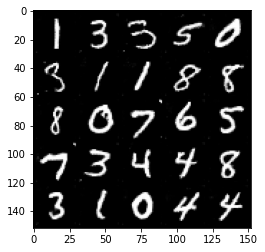

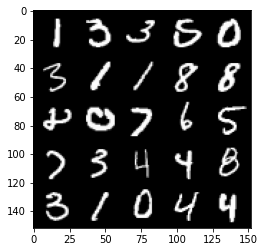

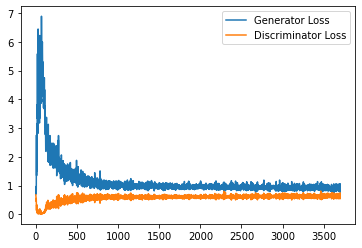

Step 74500: Generator loss: 0.91397411942482, discriminator loss: 0.6314045240879059


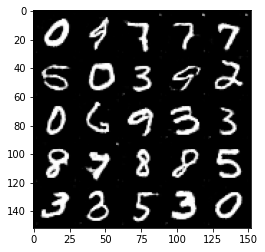

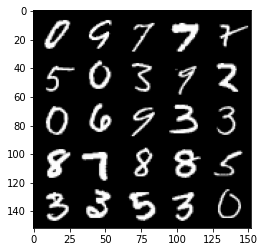

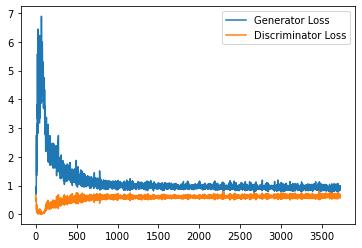

Step 75000: Generator loss: 0.9113297506570815, discriminator loss: 0.6350768283605576


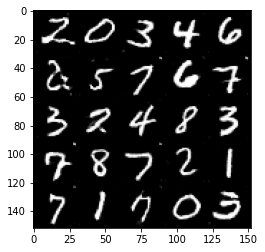

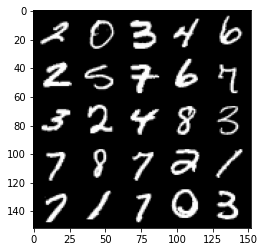

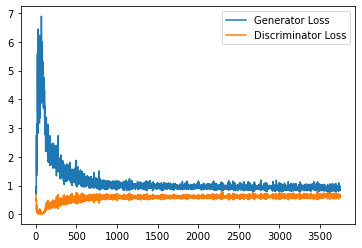

Step 75500: Generator loss: 0.9139289916753769, discriminator loss: 0.6228510122895241


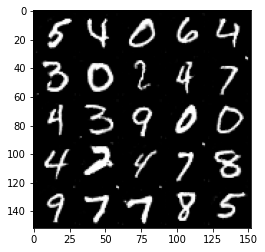

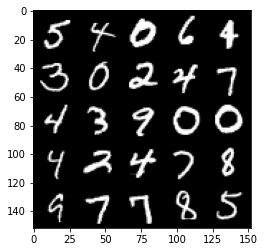

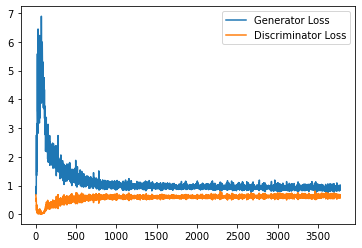

Step 76000: Generator loss: 0.9272621581554413, discriminator loss: 0.6277488971352577


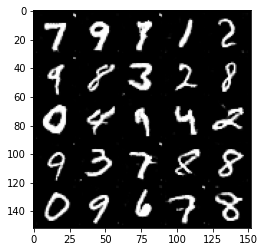

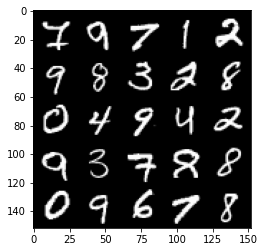

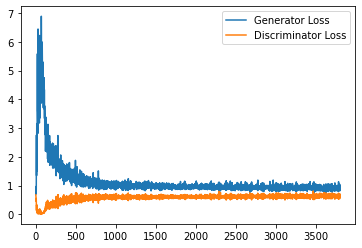

Step 76500: Generator loss: 0.9041754400730133, discriminator loss: 0.6299673529863358


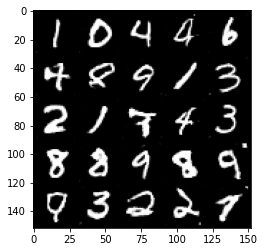

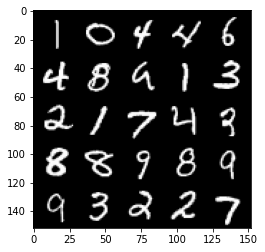

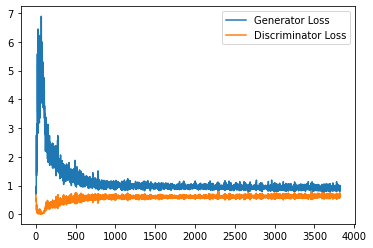

Step 77000: Generator loss: 0.902924620628357, discriminator loss: 0.6277413480281829


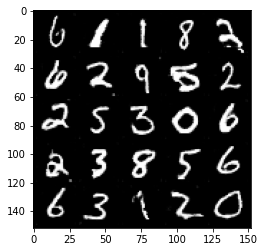

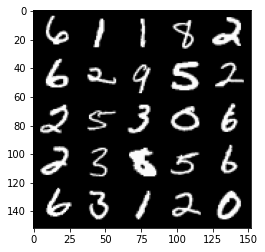

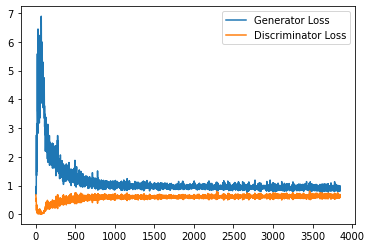

Step 77500: Generator loss: 0.9323237943649292, discriminator loss: 0.6303046503067017


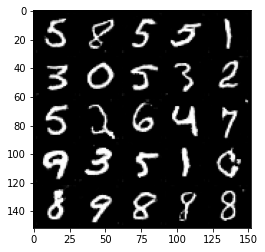

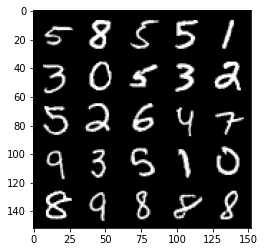

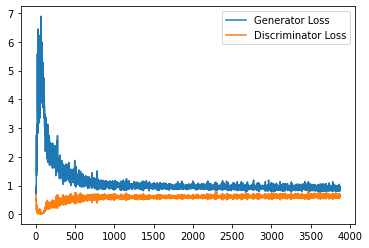

Step 78000: Generator loss: 0.9121114945411682, discriminator loss: 0.6265010100603103


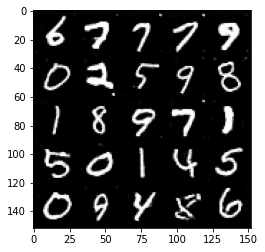

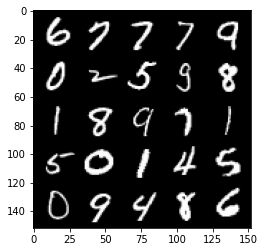

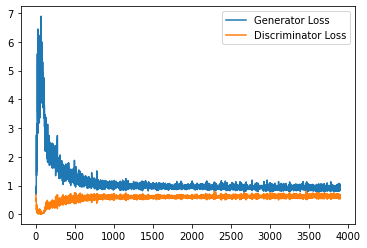

Step 78500: Generator loss: 0.9032709592580795, discriminator loss: 0.6360892117619514


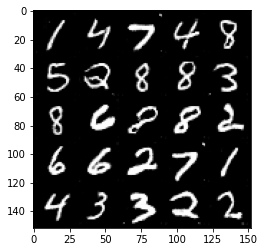

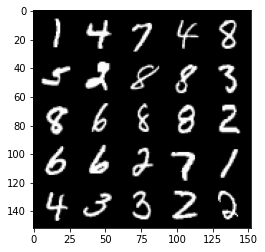

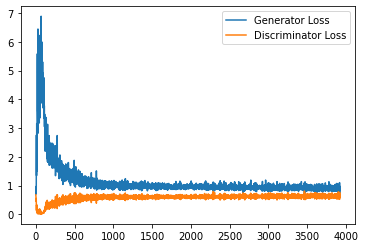

Step 79000: Generator loss: 0.9110425831079483, discriminator loss: 0.6331866728067398


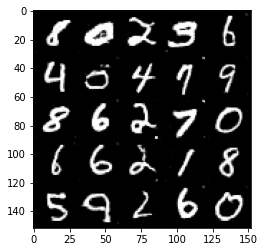

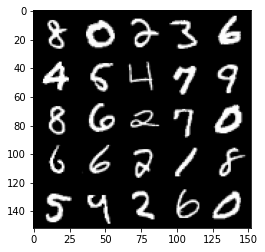

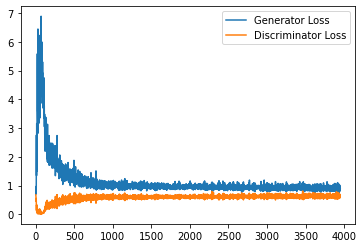

Step 79500: Generator loss: 0.9004310706853866, discriminator loss: 0.6293736562728882


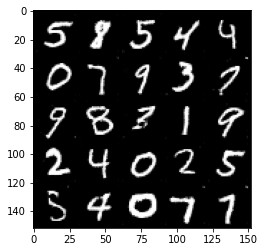

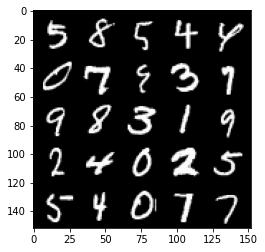

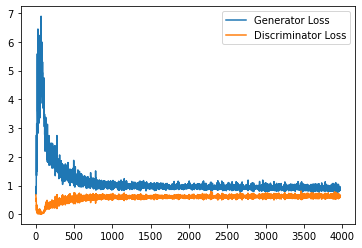

Step 80000: Generator loss: 0.9138583608865738, discriminator loss: 0.6275022165775299


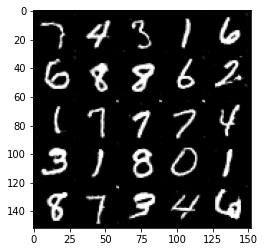

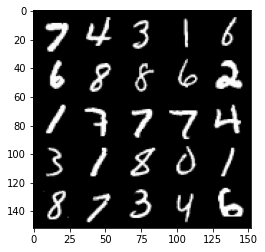

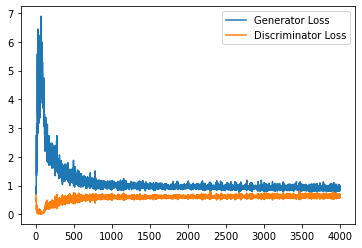

Step 80500: Generator loss: 0.9082330458164215, discriminator loss: 0.6338938340544701


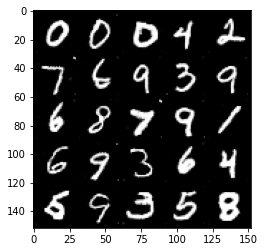

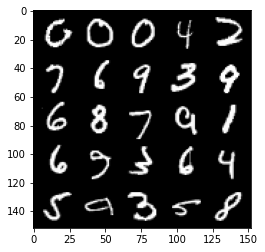

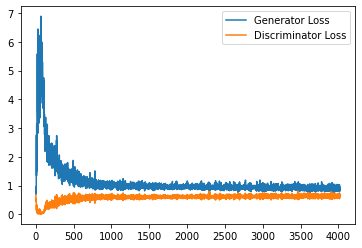

Step 81000: Generator loss: 0.911047993183136, discriminator loss: 0.6311792960762977


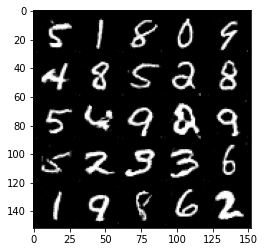

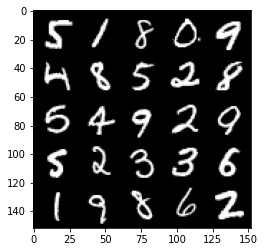

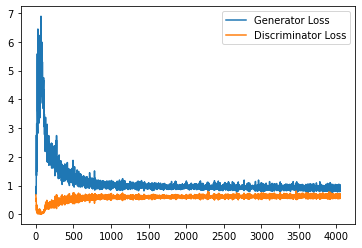

Step 81500: Generator loss: 0.9230287020206451, discriminator loss: 0.6321983358860016


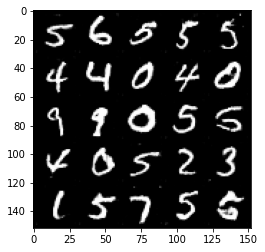

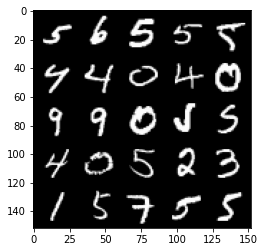

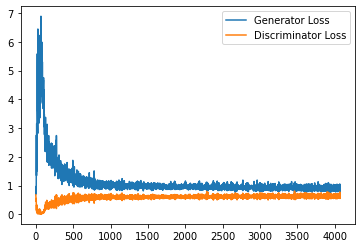

Step 82000: Generator loss: 0.8954696004390716, discriminator loss: 0.6372899372577667


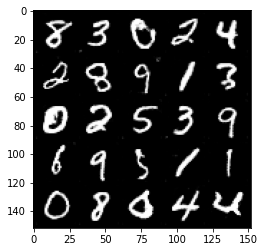

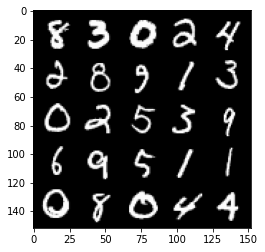

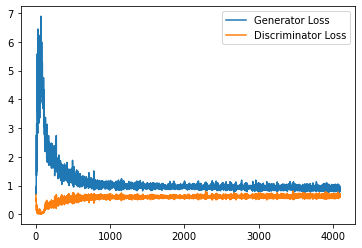

Step 82500: Generator loss: 0.9248890339136123, discriminator loss: 0.6307159910798072


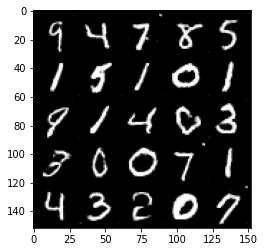

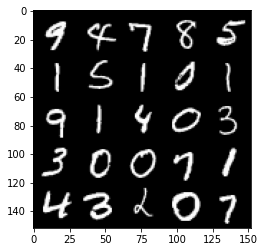

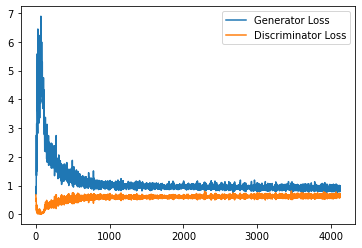

Step 83000: Generator loss: 0.9106934887170791, discriminator loss: 0.6323533867597579


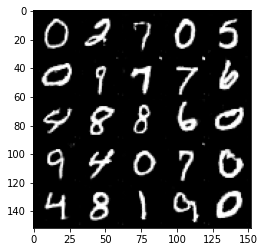

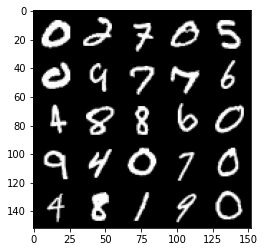

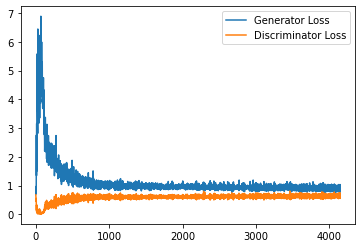

Step 83500: Generator loss: 0.9052668006420136, discriminator loss: 0.6344336861371994


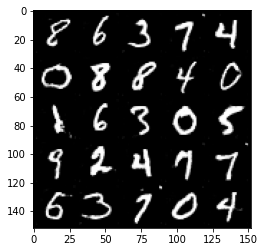

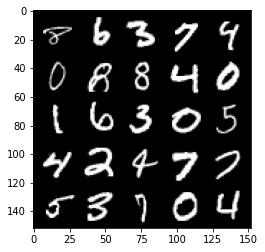

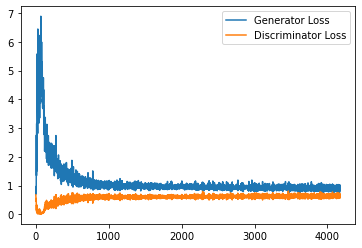

Step 84000: Generator loss: 0.8993024867773056, discriminator loss: 0.6356450054049492


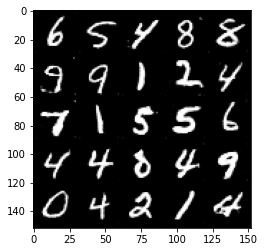

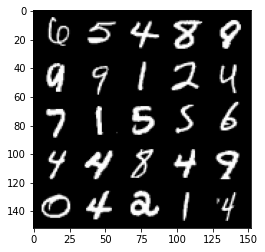

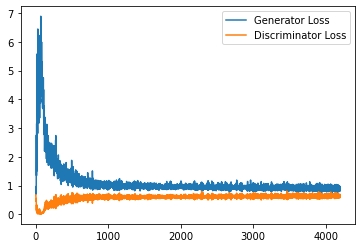

Step 84500: Generator loss: 0.9100918806791306, discriminator loss: 0.63303944170475


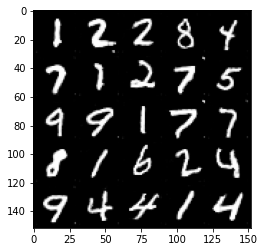

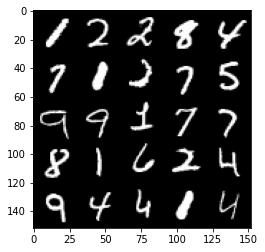

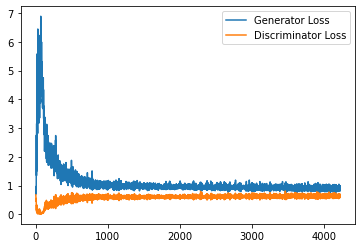

Step 85000: Generator loss: 0.9074753606319428, discriminator loss: 0.633741885125637


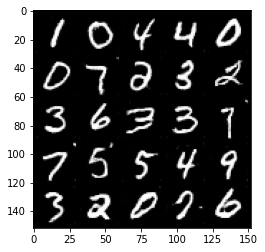

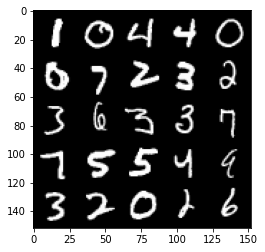

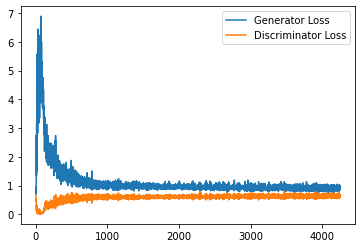

Step 85500: Generator loss: 0.9023761351108551, discriminator loss: 0.6366077462434768


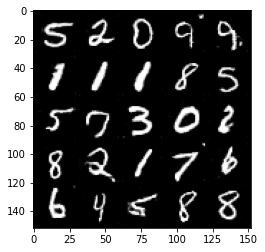

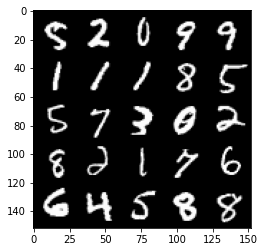

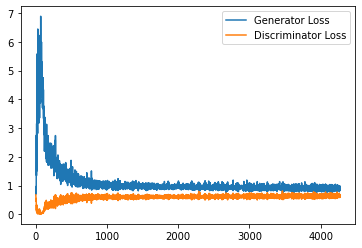

Step 86000: Generator loss: 0.9105739731788636, discriminator loss: 0.634192349910736


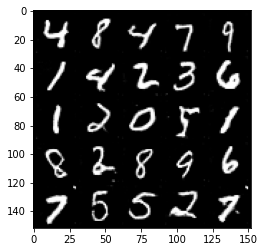

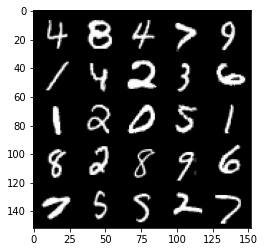

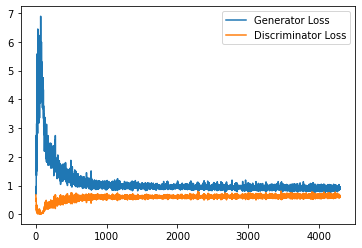

Step 86500: Generator loss: 0.8927728496789932, discriminator loss: 0.6356125196814537


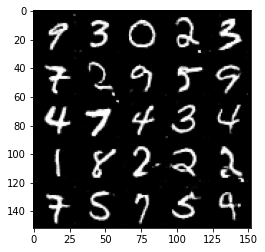

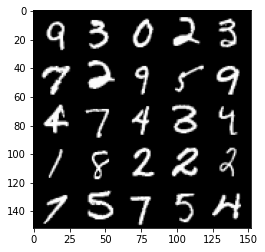

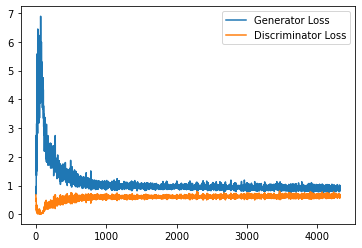

Step 87000: Generator loss: 0.9096666352748871, discriminator loss: 0.6356379563212394


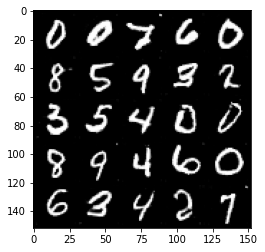

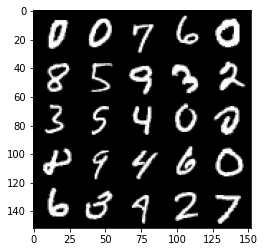

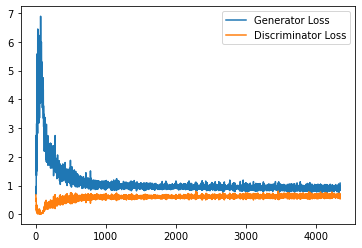

Step 87500: Generator loss: 0.8986889284849167, discriminator loss: 0.6366402622461319


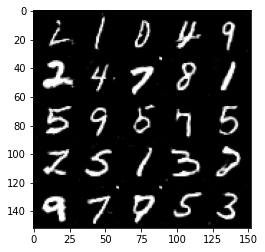

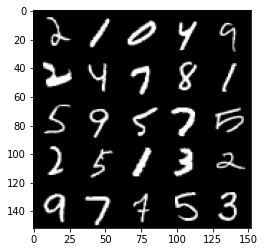

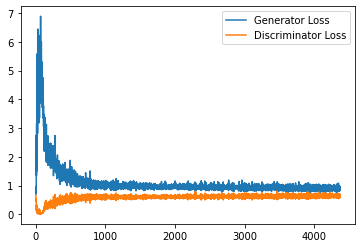

Step 88000: Generator loss: 0.9013459005355835, discriminator loss: 0.6318086742162704


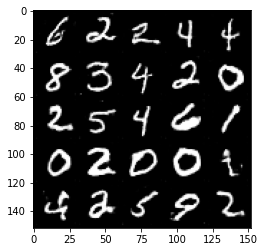

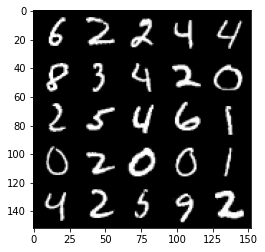

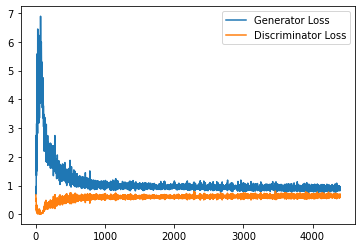

Step 88500: Generator loss: 0.9029924249649048, discriminator loss: 0.6345754552483559


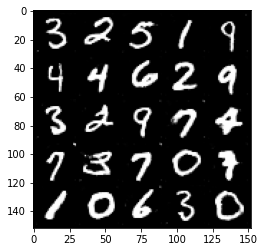

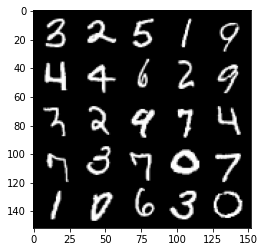

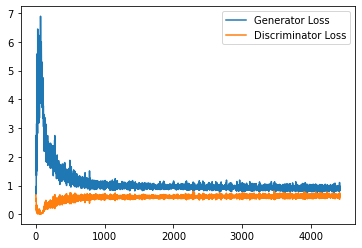

Step 89000: Generator loss: 0.8792410649061203, discriminator loss: 0.6373757284879684


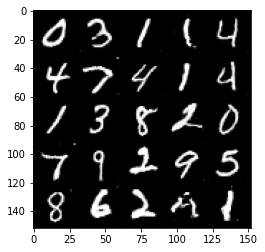

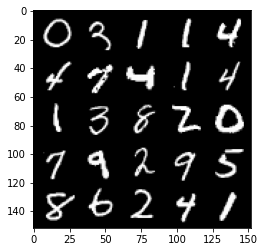

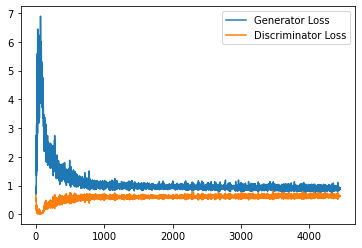

Step 89500: Generator loss: 0.8963532347679138, discriminator loss: 0.6387172636985778


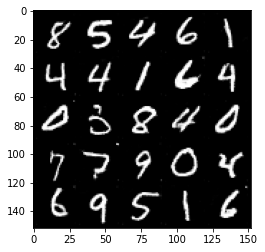

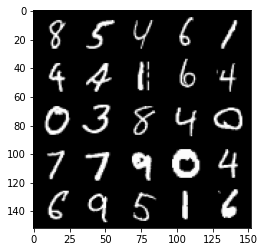

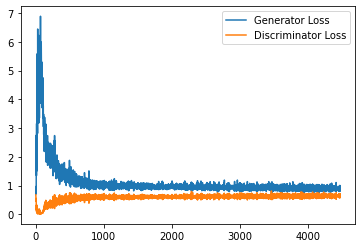

Step 90000: Generator loss: 0.8931273739337922, discriminator loss: 0.6384033298492432


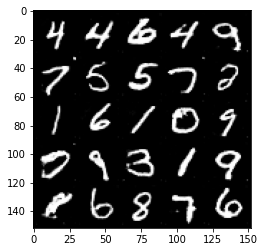

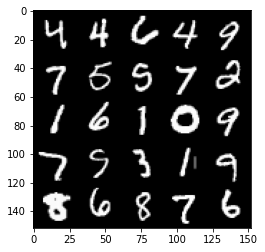

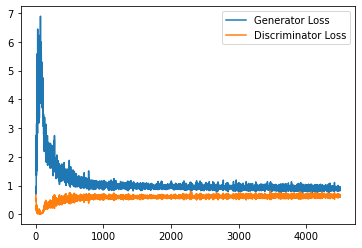

Step 90500: Generator loss: 0.8824514299631119, discriminator loss: 0.6358601447343827


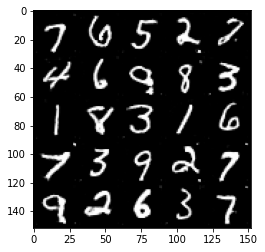

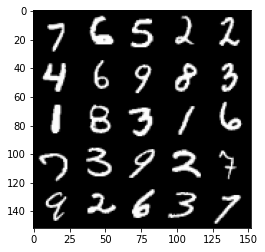

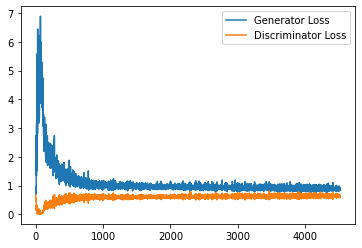

Step 91000: Generator loss: 0.894871978521347, discriminator loss: 0.63865365421772


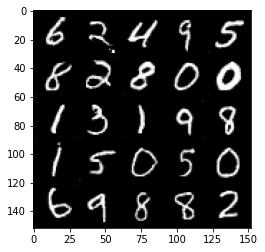

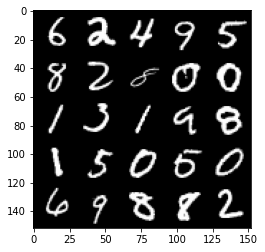

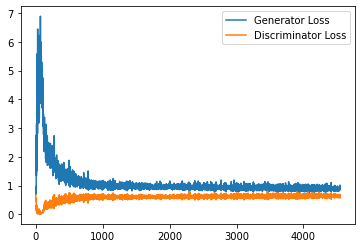

Step 91500: Generator loss: 0.8917797178030014, discriminator loss: 0.64256493973732


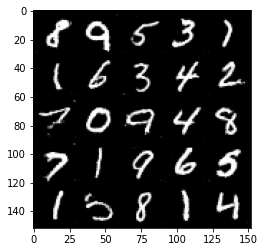

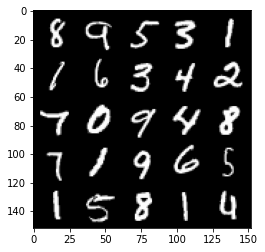

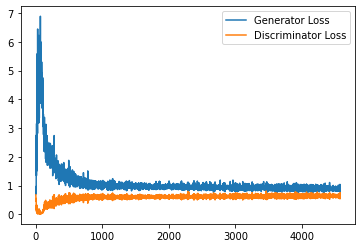

Step 92000: Generator loss: 0.8941466474533081, discriminator loss: 0.633311763048172


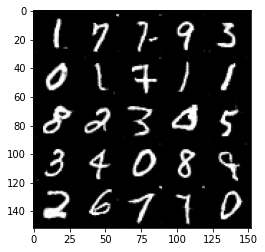

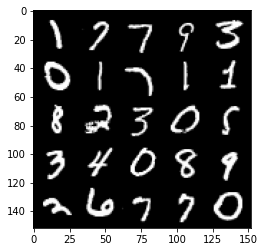

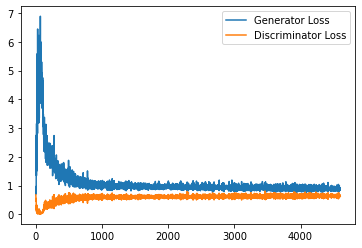

Step 92500: Generator loss: 0.8872622781991959, discriminator loss: 0.637434062242508


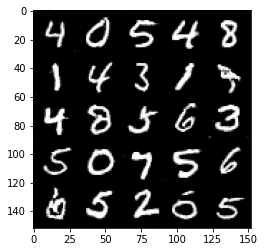

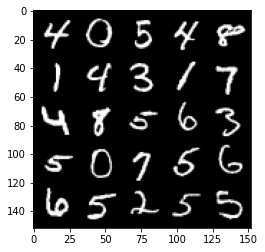

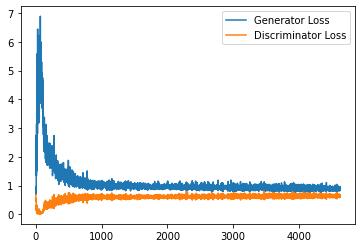

Step 93000: Generator loss: 0.8935443980693817, discriminator loss: 0.6424865970611572


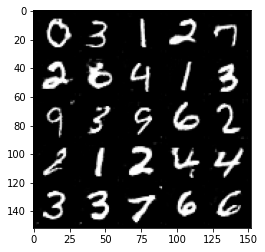

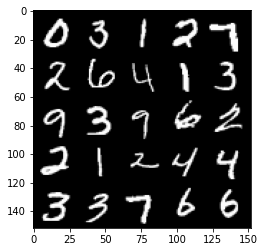

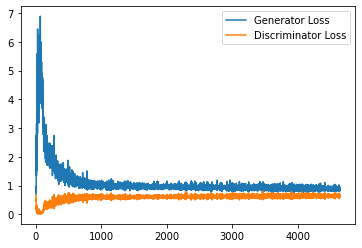

Step 93500: Generator loss: 0.8899140973091125, discriminator loss: 0.6407392637729645


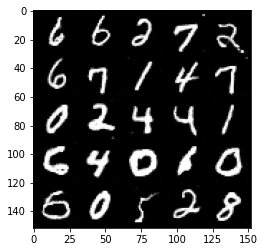

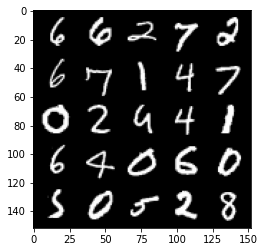

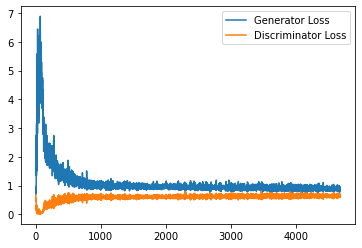

In [13]:
# UNQ_C4 (UNIQUE CELL IDENTIFIER, DO NOT EDIT)
# GRADED CELL
cur_step = 0
generator_losses = []
discriminator_losses = []

#UNIT TEST NOTE: Initializations needed for grading
noise_and_labels = False
fake = False

fake_image_and_labels = False
real_image_and_labels = False
disc_fake_pred = False
disc_real_pred = False

for epoch in range(n_epochs):
    # Dataloader returns the batches and the labels
    for real, labels in tqdm(dataloader):
        cur_batch_size = len(real)
        # Flatten the batch of real images from the dataset
        real = real.to(device)

        one_hot_labels = get_one_hot_labels(labels.to(device), n_classes)
        image_one_hot_labels = one_hot_labels[:, :, None, None]
        image_one_hot_labels = image_one_hot_labels.repeat(1, 1, mnist_shape[1], mnist_shape[2])

        ### Update discriminator ###
        # Zero out the discriminator gradients
        disc_opt.zero_grad()
        # Get noise corresponding to the current batch_size 
        fake_noise = get_noise(cur_batch_size, z_dim, device=device)
        
        # Now you can get the images from the generator
        # Steps: 1) Combine the noise vectors and the one-hot labels for the generator
        #        2) Generate the conditioned fake images
       
        #### START CODE HERE ####
        noise_and_labels = combine_vectors(fake_noise, one_hot_labels)
        fake = gen(noise_and_labels)
        #### END CODE HERE ####
        
        # Make sure that enough images were generated
        assert len(fake) == len(real)
        # Check that correct tensors were combined
        assert tuple(noise_and_labels.shape) == (cur_batch_size, fake_noise.shape[1] + one_hot_labels.shape[1])
        # It comes from the correct generator
        assert tuple(fake.shape) == (len(real), 1, 28, 28)

        # Now you can get the predictions from the discriminator
        # Steps: 1) Create the input for the discriminator
        #           a) Combine the fake images with image_one_hot_labels, 
        #              remember to detach the generator (.detach()) so you do not backpropagate through it
        #           b) Combine the real images with image_one_hot_labels
        #        2) Get the discriminator's prediction on the fakes as disc_fake_pred
        #        3) Get the discriminator's prediction on the reals as disc_real_pred
        
        #### START CODE HERE ####
        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        real_image_and_labels = combine_vectors(real, image_one_hot_labels)
        disc_fake_pred = disc(fake_image_and_labels.detach())
        disc_real_pred = disc(real_image_and_labels)
        #### END CODE HERE ####
        
        # Make sure shapes are correct 
        assert tuple(fake_image_and_labels.shape) == (len(real), fake.detach().shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        assert tuple(real_image_and_labels.shape) == (len(real), real.shape[1] + image_one_hot_labels.shape[1], 28 ,28)
        # Make sure that enough predictions were made
        assert len(disc_real_pred) == len(real)
        # Make sure that the inputs are different
        assert torch.any(fake_image_and_labels != real_image_and_labels)
        # Shapes must match
        assert tuple(fake_image_and_labels.shape) == tuple(real_image_and_labels.shape)
        assert tuple(disc_fake_pred.shape) == tuple(disc_real_pred.shape)
        
        
        disc_fake_loss = criterion(disc_fake_pred, torch.zeros_like(disc_fake_pred))
        disc_real_loss = criterion(disc_real_pred, torch.ones_like(disc_real_pred))
        disc_loss = (disc_fake_loss + disc_real_loss) / 2
        disc_loss.backward(retain_graph=True)
        disc_opt.step() 

        # Keep track of the average discriminator loss
        discriminator_losses += [disc_loss.item()]

        ### Update generator ###
        # Zero out the generator gradients
        gen_opt.zero_grad()

        fake_image_and_labels = combine_vectors(fake, image_one_hot_labels)
        # This will error if you didn't concatenate your labels to your image correctly
        disc_fake_pred = disc(fake_image_and_labels)
        gen_loss = criterion(disc_fake_pred, torch.ones_like(disc_fake_pred))
        gen_loss.backward()
        gen_opt.step()

        # Keep track of the generator losses
        generator_losses += [gen_loss.item()]
        #

        if cur_step % display_step == 0 and cur_step > 0:
            gen_mean = sum(generator_losses[-display_step:]) / display_step
            disc_mean = sum(discriminator_losses[-display_step:]) / display_step
            print(f"Step {cur_step}: Generator loss: {gen_mean}, discriminator loss: {disc_mean}")
            show_tensor_images(fake)
            show_tensor_images(real)
            step_bins = 20
            x_axis = sorted([i * step_bins for i in range(len(generator_losses) // step_bins)] * step_bins)
            num_examples = (len(generator_losses) // step_bins) * step_bins
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(generator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Generator Loss"
            )
            plt.plot(
                range(num_examples // step_bins), 
                torch.Tensor(discriminator_losses[:num_examples]).view(-1, step_bins).mean(1),
                label="Discriminator Loss"
            )
            plt.legend()
            plt.show()
        elif cur_step == 0:
            print("Congratulations! If you've gotten here, it's working. Please let this train until you're happy with how the generated numbers look, and then go on to the exploration!")
        cur_step += 1

## Exploration
You can do a bit of exploration now!

In [14]:
# Before you explore, you should put the generator
# in eval mode, both in general and so that batch norm
# doesn't cause you issues and is using its eval statistics
gen = gen.eval()

#### Changing the Class Vector
You can generate some numbers with your new model! You can add interpolation as well to make it more interesting.

So starting from a image, you will produce intermediate images that look more and more like the ending image until you get to the final image. Your're basically morphing one image into another. You can choose what these two images will be using your conditional GAN.

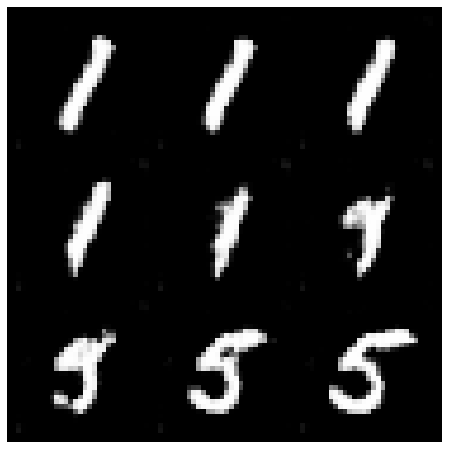

In [15]:
import math

### Change me! ###
n_interpolation = 9 # Choose the interpolation: how many intermediate images you want + 2 (for the start and end image)
interpolation_noise = get_noise(1, z_dim, device=device).repeat(n_interpolation, 1)

def interpolate_class(first_number, second_number):
    first_label = get_one_hot_labels(torch.Tensor([first_number]).long(), n_classes)
    second_label = get_one_hot_labels(torch.Tensor([second_number]).long(), n_classes)

    # Calculate the interpolation vector between the two labels
    percent_second_label = torch.linspace(0, 1, n_interpolation)[:, None]
    interpolation_labels = first_label * (1 - percent_second_label) + second_label * percent_second_label

    # Combine the noise and the labels
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_labels.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

### Change me! ###
start_plot_number = 1 # Choose the start digit
### Change me! ###
end_plot_number = 5 # Choose the end digit

plt.figure(figsize=(8, 8))
interpolate_class(start_plot_number, end_plot_number)
_ = plt.axis('off')

### Uncomment the following lines of code if you would like to visualize a set of pairwise class 
### interpolations for a collection of different numbers, all in a single grid of interpolations.
### You'll also see another visualization like this in the next code block!
# plot_numbers = [2, 3, 4, 5, 7]
# n_numbers = len(plot_numbers)
# plt.figure(figsize=(8, 8))
# for i, first_plot_number in enumerate(plot_numbers):
#     for j, second_plot_number in enumerate(plot_numbers):
#         plt.subplot(n_numbers, n_numbers, i * n_numbers + j + 1)
#         interpolate_class(first_plot_number, second_plot_number)
#         plt.axis('off')
# plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
# plt.show()
# plt.close()

#### Changing the Noise Vector
Now, what happens if you hold the class constant, but instead you change the noise vector? You can also interpolate the noise vector and generate an image at each step.

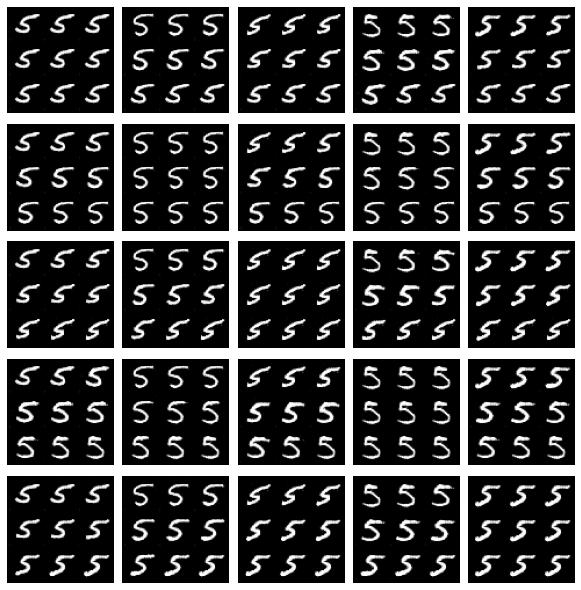

In [16]:
n_interpolation = 9 # How many intermediate images you want + 2 (for the start and end image)

# This time you're interpolating between the noise instead of the labels
interpolation_label = get_one_hot_labels(torch.Tensor([5]).long(), n_classes).repeat(n_interpolation, 1).float()

def interpolate_noise(first_noise, second_noise):
    # This time you're interpolating between the noise instead of the labels
    percent_first_noise = torch.linspace(0, 1, n_interpolation)[:, None].to(device)
    interpolation_noise = first_noise * percent_first_noise + second_noise * (1 - percent_first_noise)

    # Combine the noise and the labels again
    noise_and_labels = combine_vectors(interpolation_noise, interpolation_label.to(device))
    fake = gen(noise_and_labels)
    show_tensor_images(fake, num_images=n_interpolation, nrow=int(math.sqrt(n_interpolation)), show=False)

# Generate noise vectors to interpolate between
### Change me! ###
n_noise = 5 # Choose the number of noise examples in the grid
plot_noises = [get_noise(1, z_dim, device=device) for i in range(n_noise)]
plt.figure(figsize=(8, 8))
for i, first_plot_noise in enumerate(plot_noises):
    for j, second_plot_noise in enumerate(plot_noises):
        plt.subplot(n_noise, n_noise, i * n_noise + j + 1)
        interpolate_noise(first_plot_noise, second_plot_noise)
        plt.axis('off')
plt.subplots_adjust(top=1, bottom=0, left=0, right=1, hspace=0.1, wspace=0)
plt.show()
plt.close()